# Advanced Lane Line Finding
In this project, your goal is to write a software pipeline to identify the lane boundaries in a video, but the main output or product we want you to create is a detailed writeup of the project.

## Step 1: Camera calibration


The first step of the image processing pipeline is camera calibration in order to fix the image distortation problem from the effect of camera lens. The project provides 20 chessboard camera images to help us do the camera calibration. I use the cv2.findChessboardCorners() function in order to find all chessboard corners on these images. After that, I use the cv2.calibrateCamera() function to find the distortion array of the camera lens. Finally, I apply the cv2.undistort() function to get undistorted images.

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib qt

# The debug flag to control debug printing
debug = True

# Load all images on one folder - return images and gray images
def load_images(image_paths):
    images = []
    gray_images = []
    for idx, image_path in enumerate(image_paths):
        img = cv2.imread(image_path)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        images.append(img)
        gray_images.append(gray)
    return images, gray_images

# Find the camera image calibration points based on the chaessboard images from camera
def find_Calibration_Points(image_paths, nx=9, ny=6):
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane
    for idx, image_path in enumerate(image_paths):
        img = cv2.imread(image_path)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
    return objpoints, imgpoints
        
        
# load test images
cali_images = glob.glob('camera_cal/*.jpg')

objpoints, imgpoints = find_Calibration_Points(cali_images)



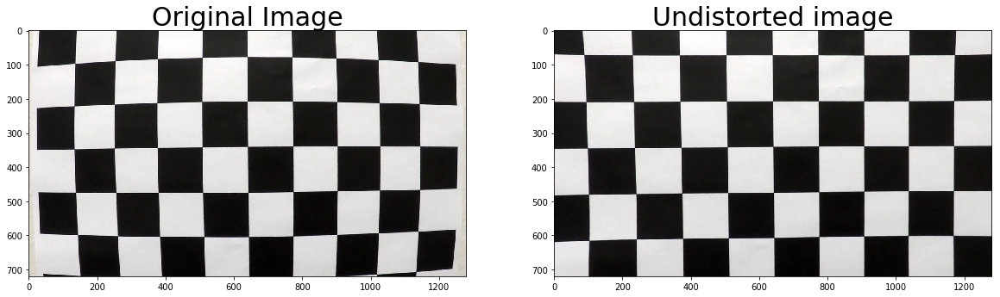

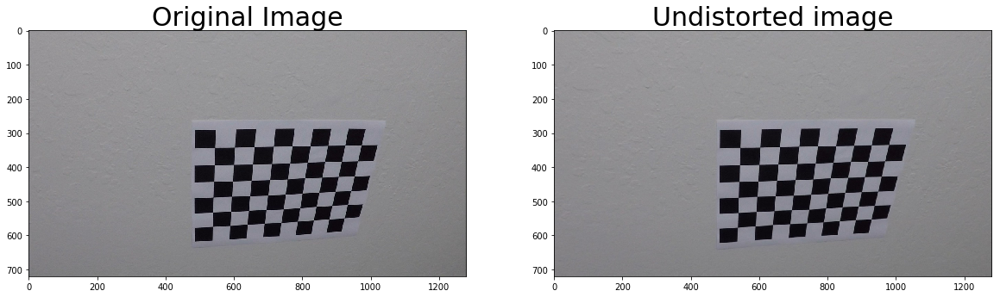

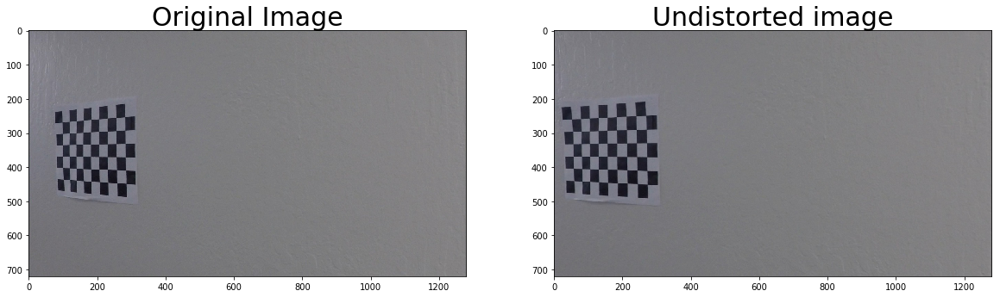

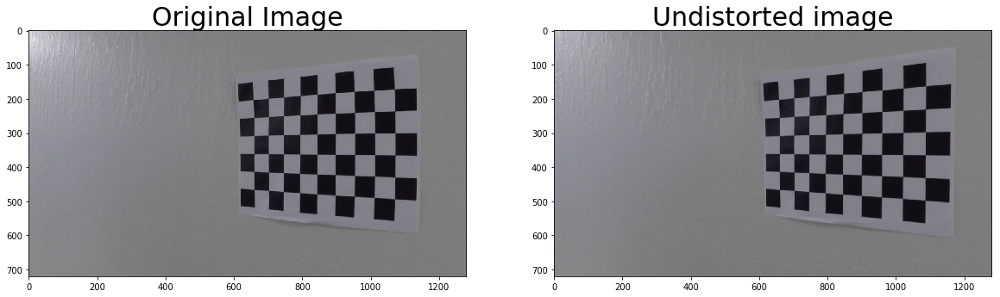

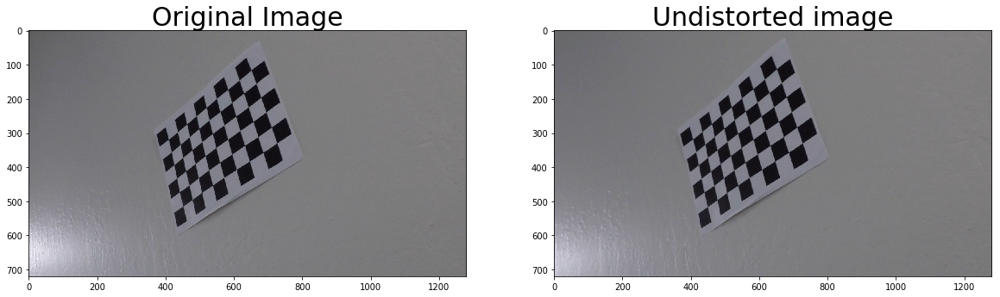

...

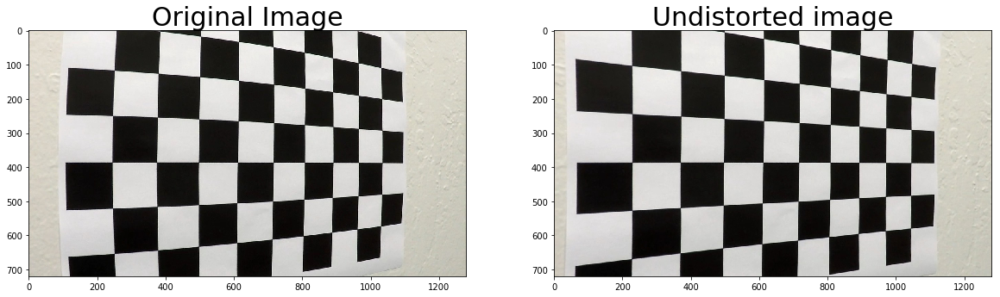

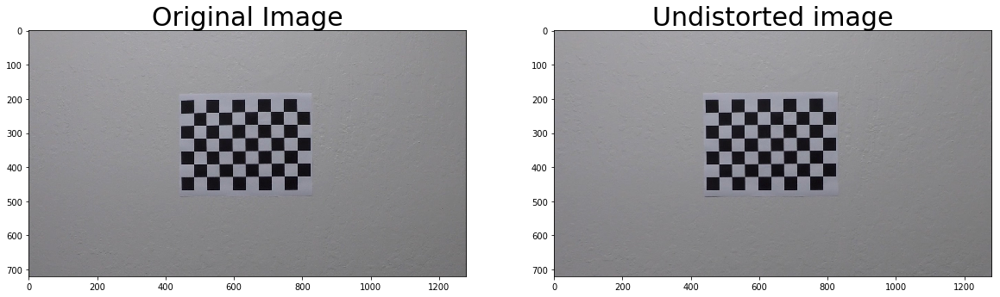

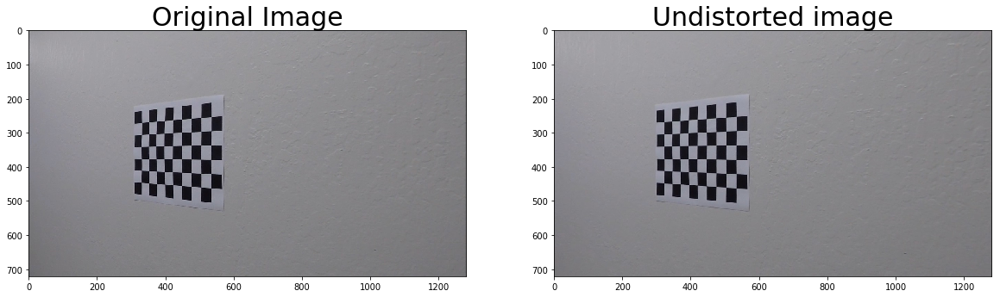

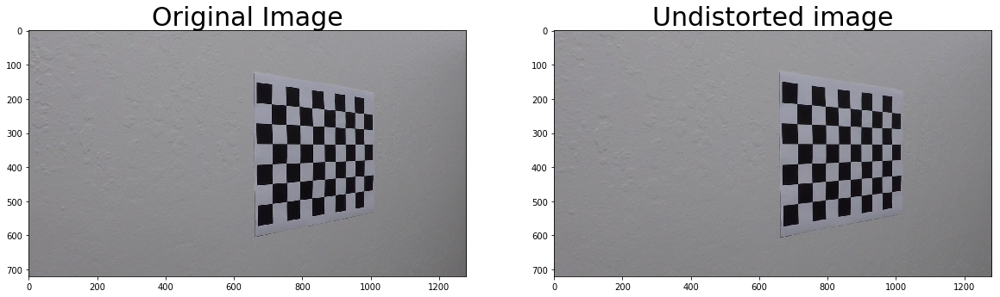

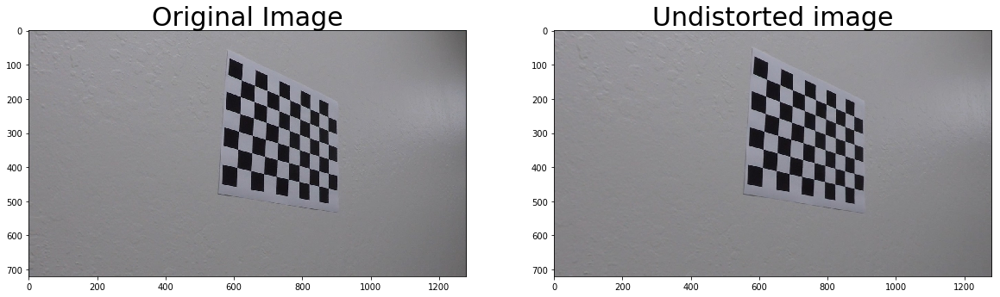

In [7]:
import pickle
%matplotlib inline

OUTPUT_IMAGES = 'output_images'
# The unility function use to show 2 test images
def show2images(image1, title1, image2, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    if (len(image1.shape) == 2):
        ax1.imshow(image1, cmap = 'gray')
    else:
        ax1.imshow(image1)
    ax1.set_title(title1, fontsize=30)
    if (len(image2.shape) == 2):
        ax2.imshow(image2, cmap = 'gray')
    else:
        ax2.imshow(image2)
    ax2.set_title(title2, fontsize=30)

# The unility function use to show 3 test images
def show3images(image1, title1, image2, title2, image3, title3):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))
    if (len(image1.shape) == 2):
        ax1.imshow(image1, cmap = 'gray')
    else:
        ax1.imshow(image1)
    ax1.set_title(title1, fontsize=30)
    if (len(image2.shape) == 2):
        ax2.imshow(image2, cmap = 'gray')
    else:
        ax2.imshow(image2)
    ax2.set_title(title2, fontsize=30)
    if (len(image3.shape) == 2):
        ax3.imshow(image3, cmap = 'gray')
    else:
        ax3.imshow(image3)
    ax3.set_title(title3, fontsize=30)

# Test calibration image
test_calibration_image = cv2.imread(cali_images[4])
img_size = (test_calibration_image.shape[0], test_calibration_image.shape[1])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle.p", "wb" ) )

if debug:
    for idx, image_path in enumerate(cali_images):
        img = mpimg.imread(image_path)
        dst = cv2.undistort(img, mtx, dist, None, mtx)
        cv2.imwrite(OUTPUT_IMAGES + '/camera_cal/{}.jpg'.format(idx + 1), dst)
        show2images(img, 'Original Image', dst, 'Undistorted image')
       

## Step 2 Distortion correction

After do the camera calibration, I have the camera distortion arrays. Now I apply it to undistort the test images and save the undistorted images to output folder.

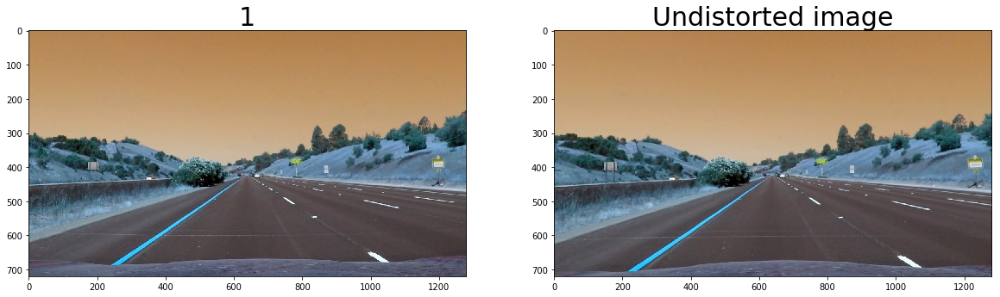

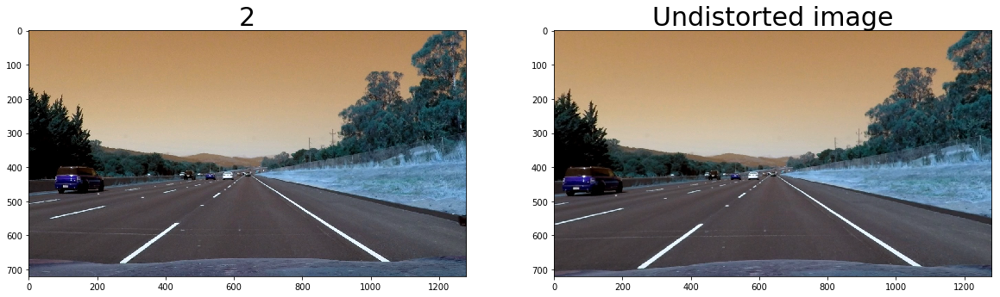

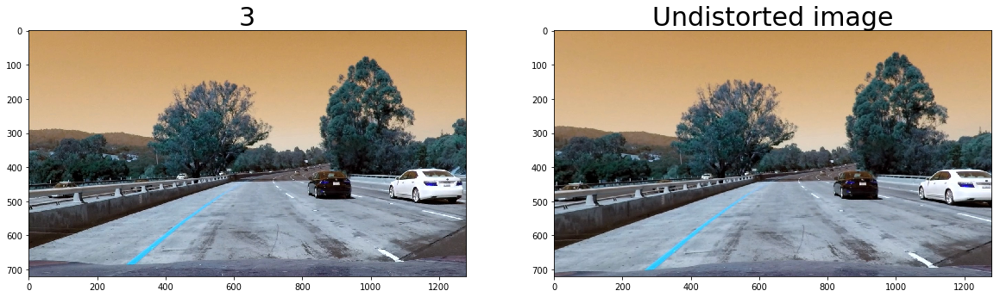

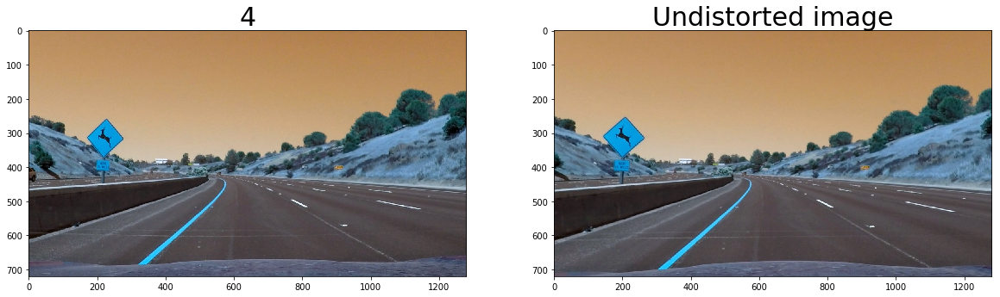

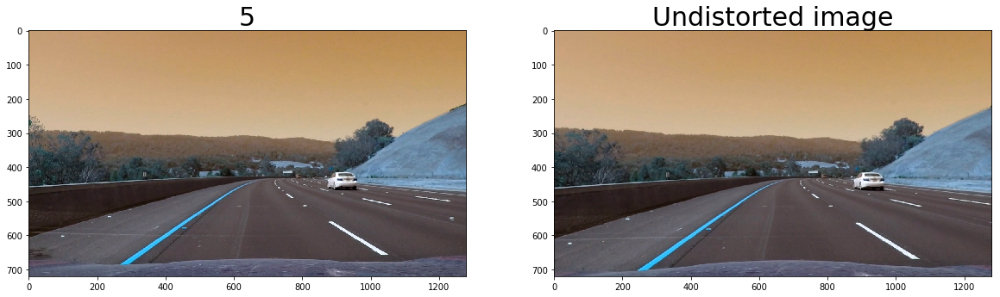

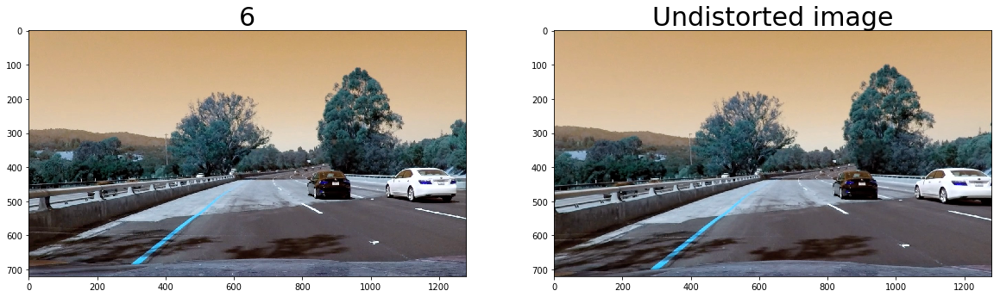

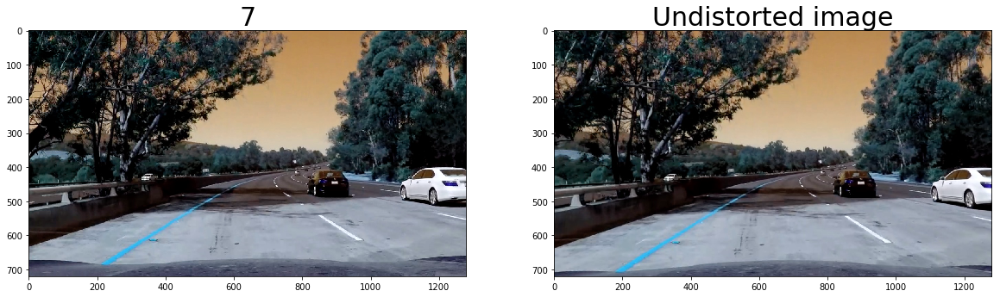

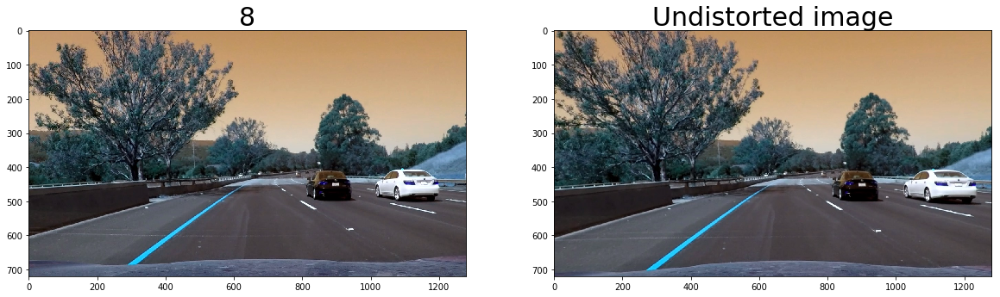

In [8]:
TEST_IMAGES_FOLDER = 'test_images'
# Test undistort on test_images
test_image_paths = glob.glob(TEST_IMAGES_FOLDER + '/*.jpg')
test_images, test_gray_images = load_images(test_image_paths)
test_dst_images = []
for idx, img in enumerate(test_images):
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    test_dst_images.append(dst)
    if debug:
        # Visualize undistortion
        show2images(img, idx + 1, dst, 'Undistorted image')
        cv2.imwrite('{}/{}/{}/{}.jpg'.format(OUTPUT_IMAGES, TEST_IMAGES_FOLDER, 'undistorted',idx + 1), dst)

## Step 3 Color and gradient threshold

I have tried many color and gradient threshold approaches on lession in order to choose the best approach.

### Sobel threshold

I apply the Sobel operator in order to take the derivative of the image in the x or y direction. I try with the sobel threshold operation in the x direction on the test images. The output shows that it can work well with solid lines but not on dashed lines, and also cannot detect lines on the bright condition (image 3, 6 and 7).

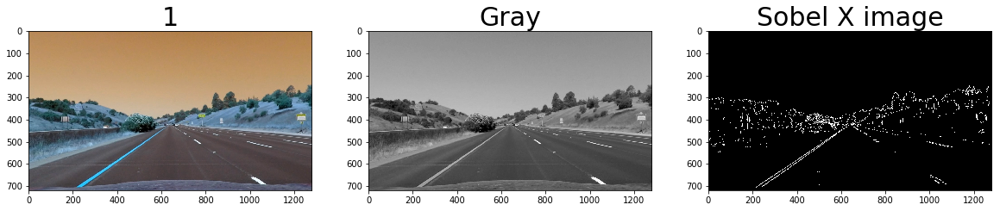

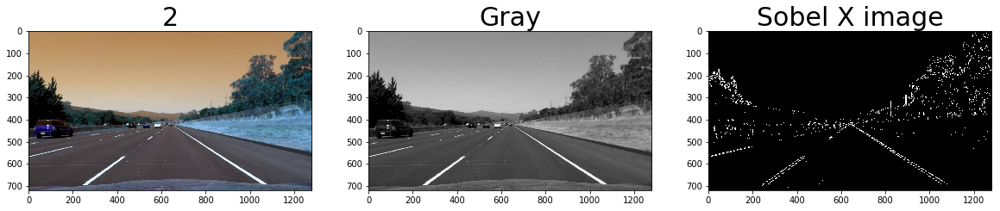

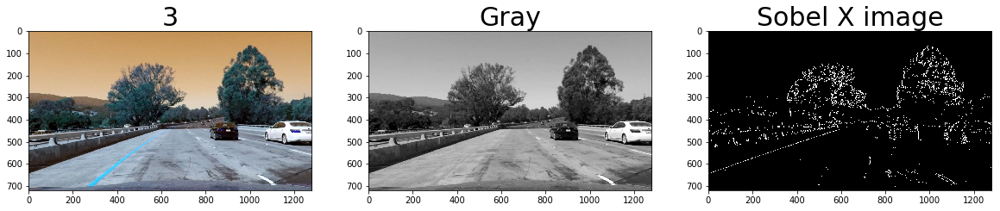

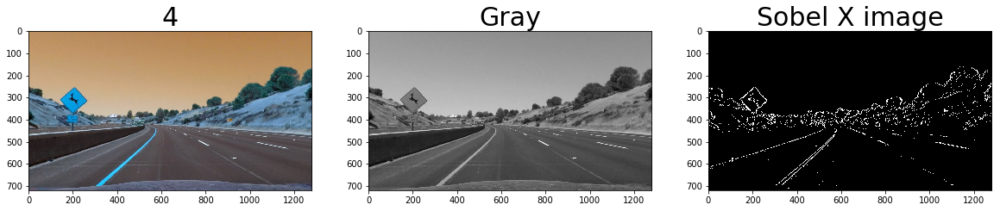

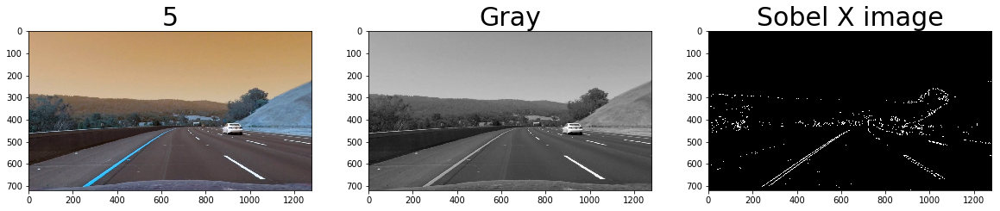

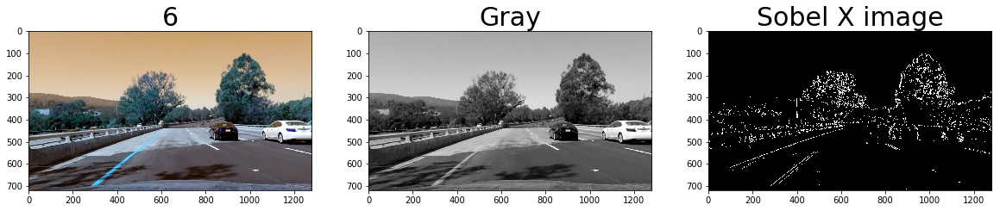

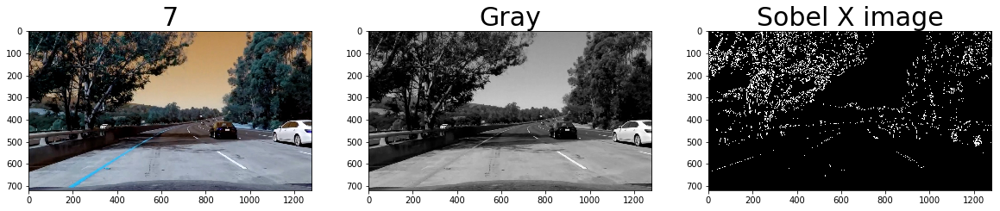

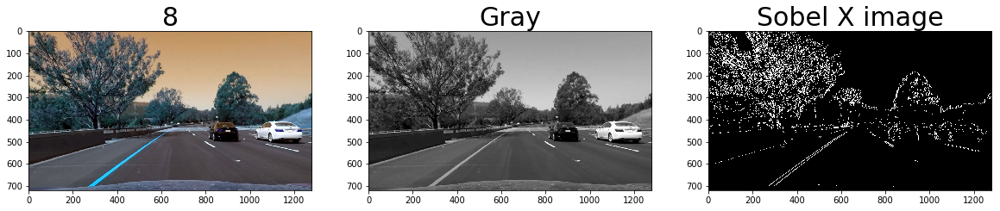

In [10]:
# Apply the sobel operator function to take the derivative of the image in the x or y orient.
def abs_sobel_thresh(gray, orient='x', thresh_min=0, thresh_max=255):
    
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    
    abs_sobel = np.absolute(sobel)
    
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    sxbinary = np.zeros_like(scaled_sobel)
    
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    return sxbinary

for idx, dst in enumerate(test_dst_images):
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY)
    abs_sobel_img = abs_sobel_thresh(gray, orient='x', thresh_min=30, thresh_max=100)
    if debug:
        show3images(dst, idx + 1, gray, 'Gray', abs_sobel_img, 'Sobel X image')


### Magnitude of the Gradient

I apply a thresold to the overall magnitude of the gradient in both x and y directions. It does not work on bright condition with a lot of noise.

Done


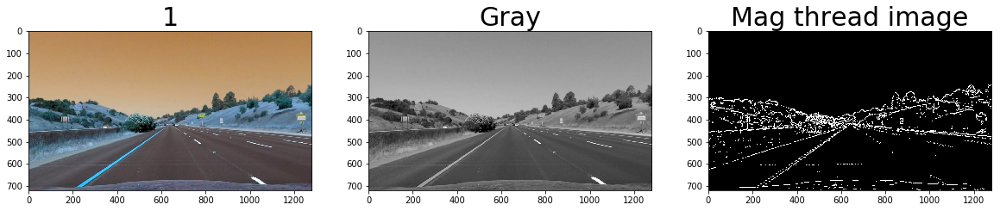

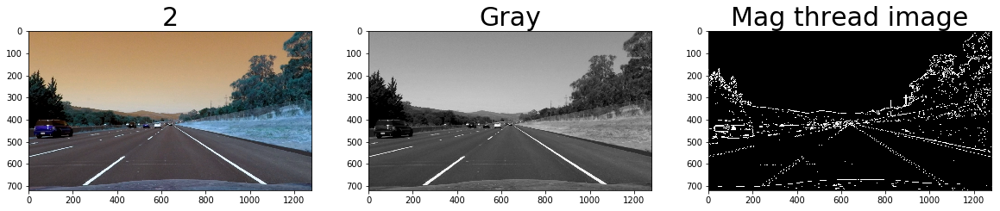

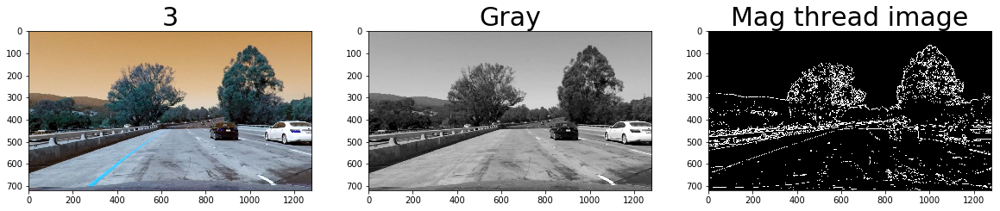

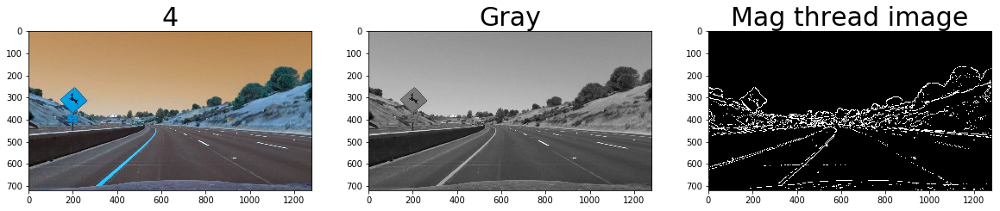

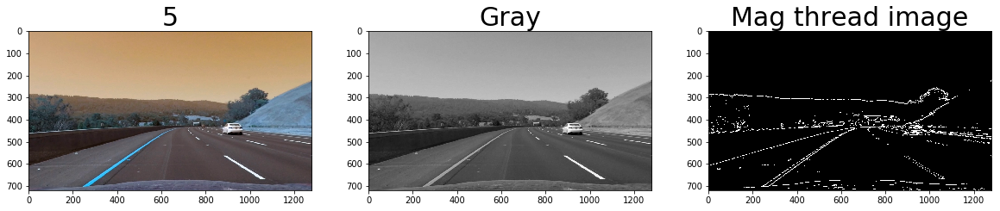

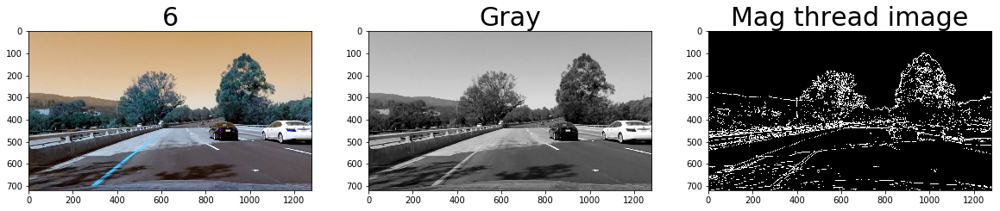

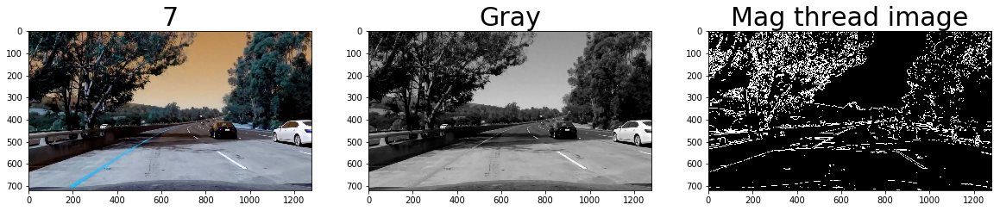

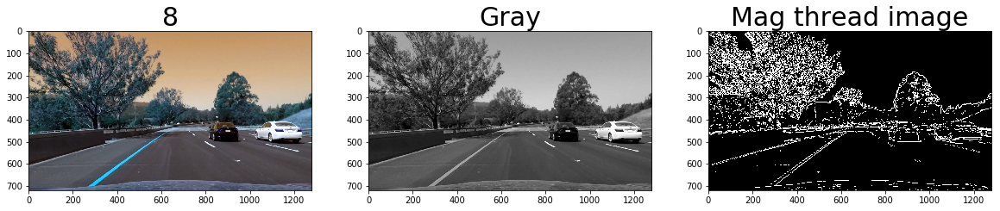

In [11]:
# Apply the overall magnitude of the gradient in both x and y directions
def mag_thresh(gray, sobel_kernel=9, mag_thresh=(30, 100)):
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    #  Calculate the magnitude
    abs_sobel = np.sqrt(sobelx**2 + sobely**2)
    #  Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    #  Create a binary mask where mag thresholds are met
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    return sxbinary

for idx, dst in enumerate(test_dst_images):
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY)
    mag_thresh_img = mag_thresh(gray, sobel_kernel=13, mag_thresh=(30, 100))
    if debug:
        show3images(dst, idx + 1, gray, 'Gray', mag_thresh_img, 'Mag thread image')
print('Done')    
# Result: Not good at bright codition (3,6,7)
# A lot of noise with horizitional line

### Direction of the Gradient

In order to detect edges of a particular direction, I try to explore the direction of the gradient. It can detect well on normal condition but not on some bright images (3, 6 and 7). And it also contains a lot of noise.

Done


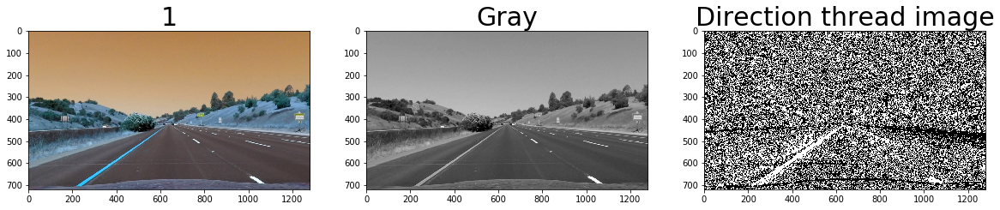

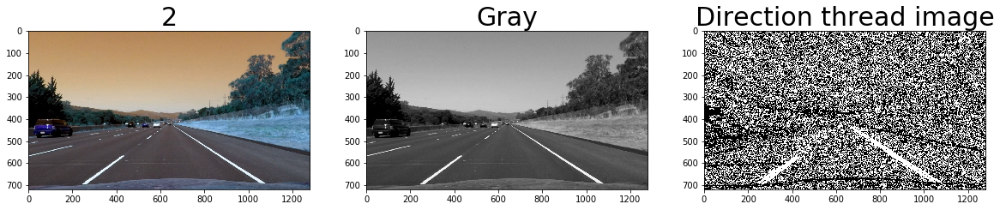

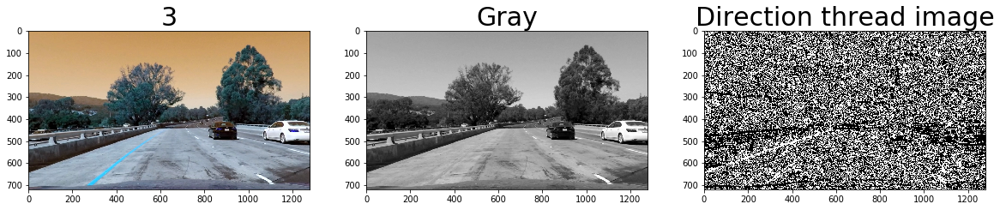

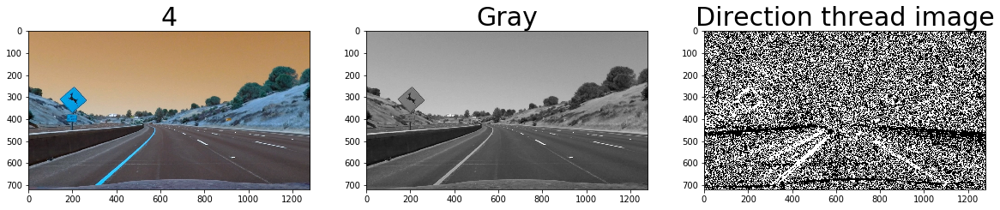

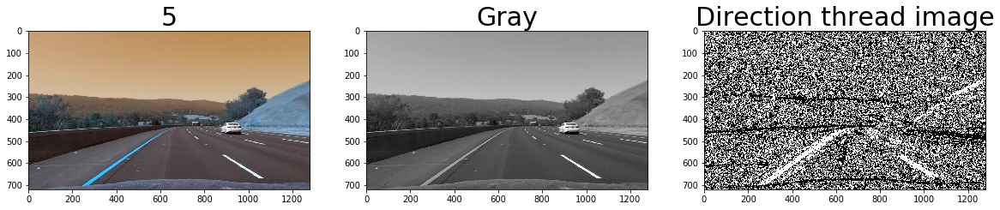

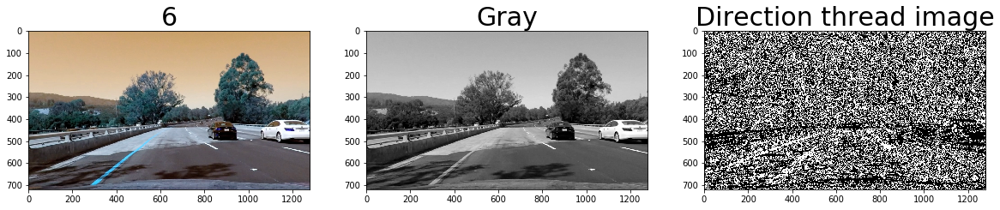

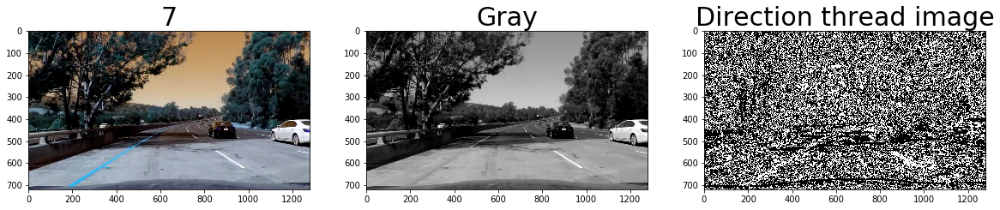

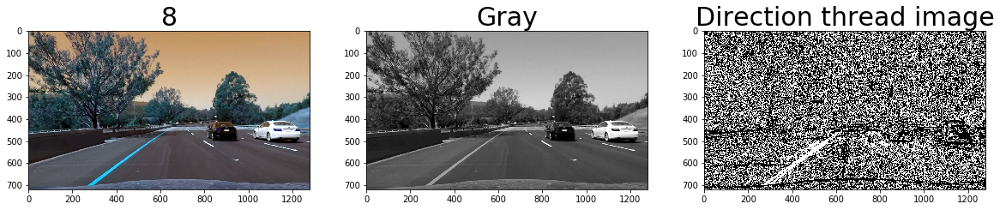

In [12]:
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # 1) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 2) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 3) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    grad_direction = np.arctan2(abs_sobely, abs_sobelx)
    # 4) Create a binary mask where direction thresholds are met
    # 5) Return this mask as your binary_output image
    sxbinary = np.zeros_like(grad_direction)
    sxbinary[(grad_direction >= thresh[0]) & (grad_direction <= thresh[1])] = 1
    return sxbinary

for idx, dst in enumerate(test_dst_images):
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY)
    dir_threshold_img = dir_threshold(gray, sobel_kernel=15, thresh=(0.6, 1.3))
    if debug:
        show3images(dst, idx + 1, gray, 'Gray', dir_threshold_img, 'Direction thread image')
print('Done')      
# Result: Good detect with normal codition
# Not good on bright images 3, 6,7
# A lot of noise

### Combining thresholds

I try to combine different thresholds together. The output is not my expectation because it still has issues on dashed lines and bright condition.

Done


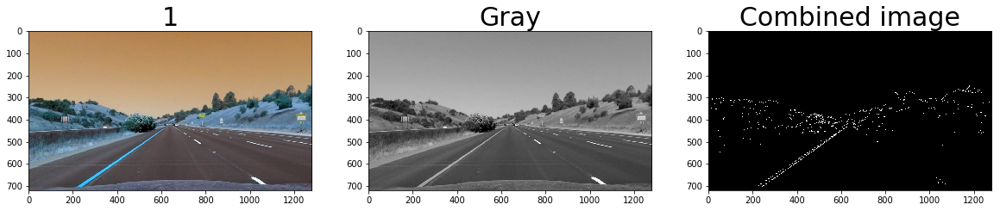

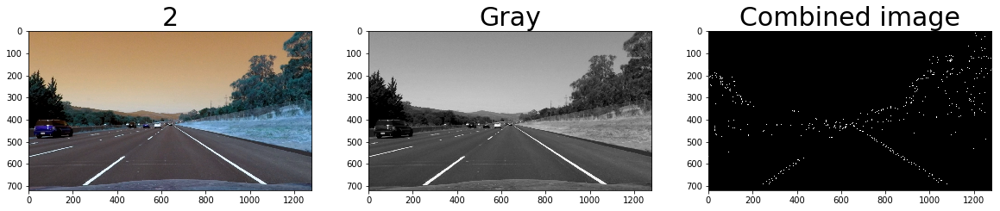

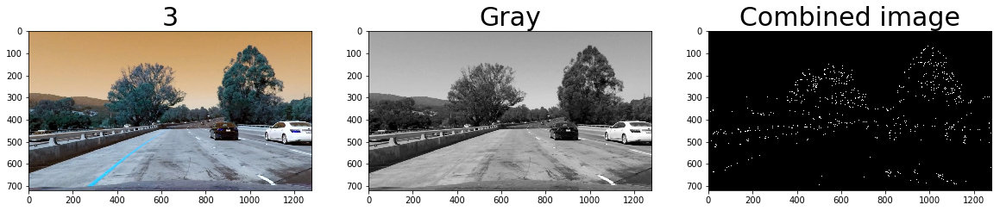

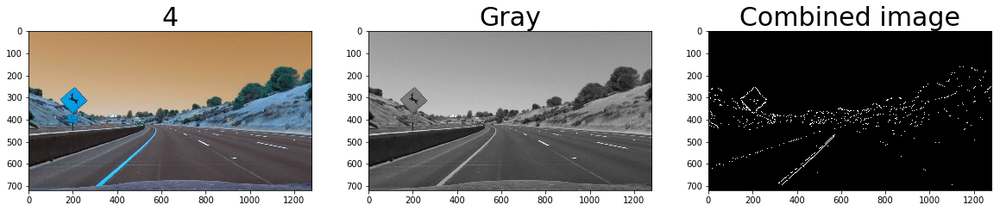

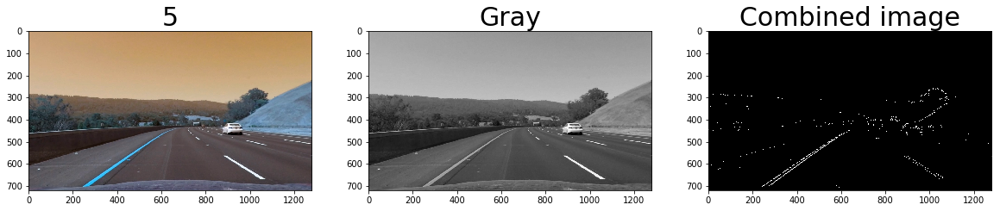

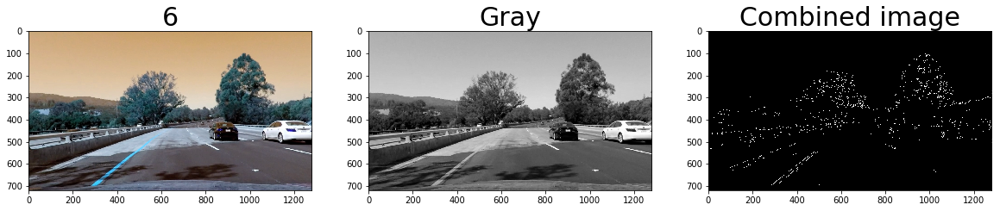

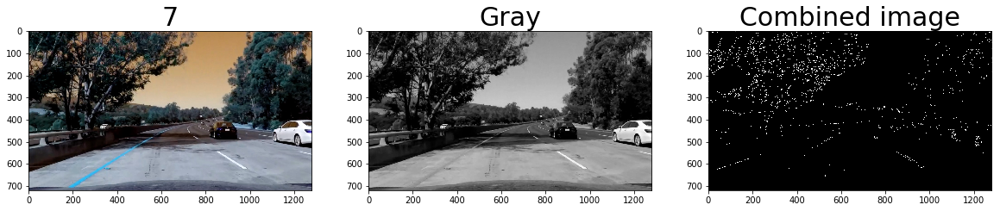

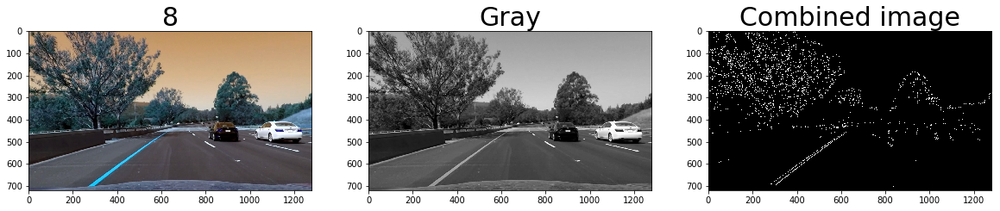

In [13]:
# Combine thresholds
ksize = 15
for idx, dst in enumerate(test_dst_images):
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY)
    gradx = abs_sobel_thresh(gray, orient='x', thresh_min=30, thresh_max=100)
    grady = abs_sobel_thresh(gray, orient='y', thresh_min=30, thresh_max=100)
    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(0.6, 1.3))
    
    combined = np.zeros_like(dir_binary)
    #combined[((gradx == 1) & (grady == 1)) & ((mag_binary == 1) & (dir_binary == 1))] = 1
    #combined[((gradx == 1) & (dir_binary == 1)) | ((mag_binary == 1) & (grady == 1))] = 1
    combined[((gradx == 1) & (dir_binary == 1) & (mag_binary == 1))] = 1
    #combined[((gradx == 1) | ((dir_binary == 1) & (mag_binary == 1)))] = 1
    if debug:
        show3images(dst, idx + 1, gray, 'Gray', combined, 'Combined image')
print('Done')    

### HSL and color thresholds

It's easy recognize that the lighting information does not have so much value for lane detection and it makes a lot of noise on output. So I try to convert the image from RGB to HLS (hue, lightness, and saturation) color space and apply color thresholds on S (saturation) and H (hue) channels.

Applying threshold on the S (saturation) channel give the output that near my expectaction. I can detect lines under bright condition however it misses some dashed lines.

Done


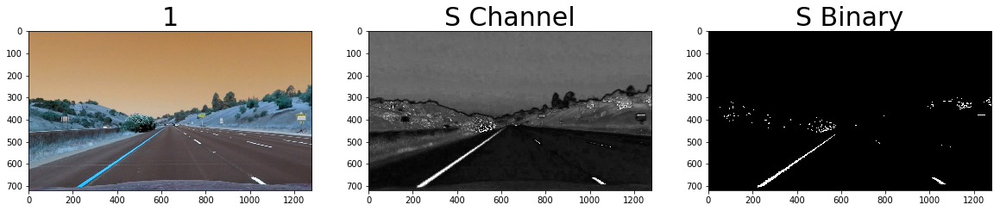

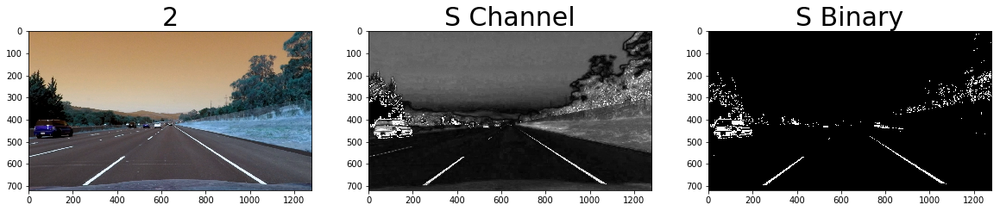

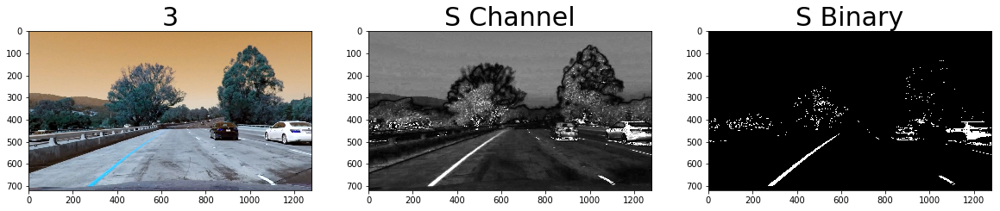

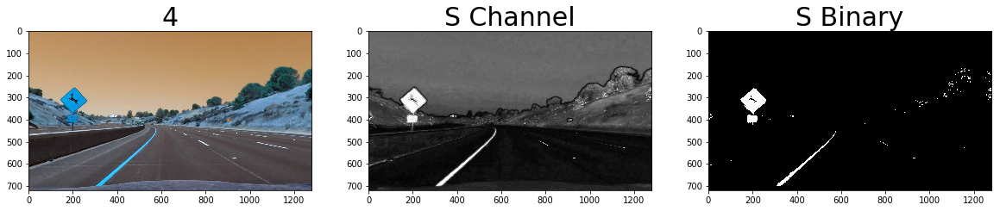

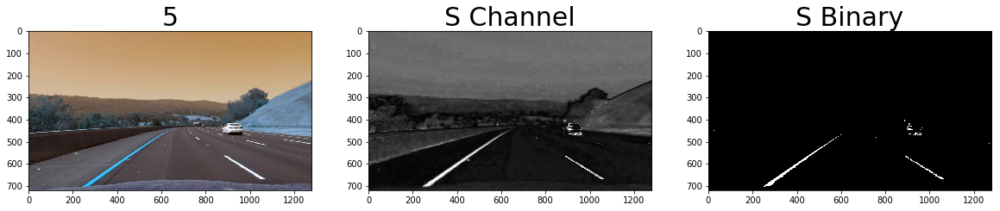

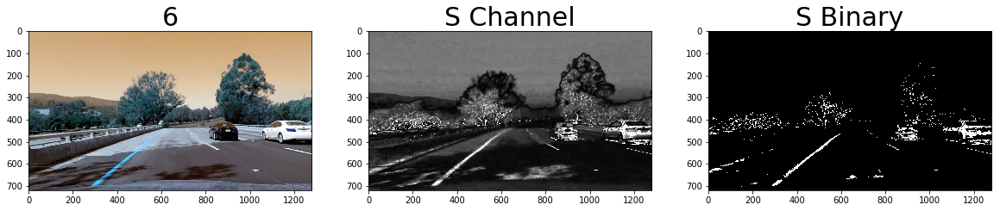

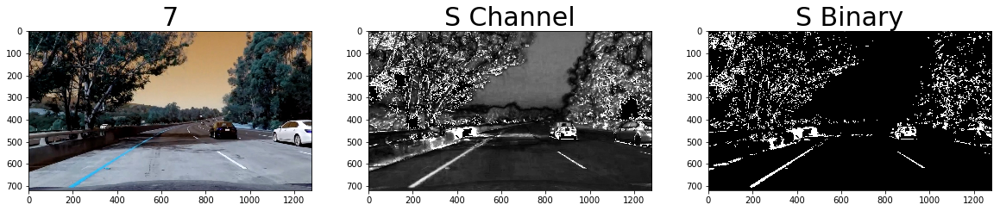

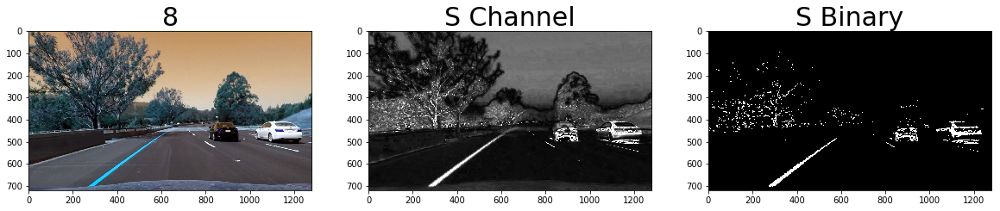

In [14]:
# The function to apply threshold to a single channel image.
def channel_select(c_image, thresh=(0,255)):
    binary_output = np.zeros_like(c_image)
    binary_output[(c_image > thresh[0]) & (c_image <= thresh[1])] = 1
    return binary_output
# Try to apply threshold on the S channel image
for idx, dst in enumerate(test_dst_images):
    hls = cv2.cvtColor(dst, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    s_binary = channel_select(S, thresh=(150, 255))
    if debug:
        show3images(dst, idx + 1, S, "S Channel", s_binary, "S Binary")
print('Done')    

Applying threshold on the H (hue) channel gives a lot of noise on output.

Done


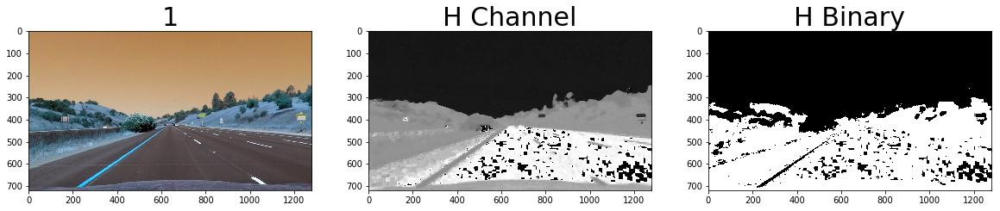

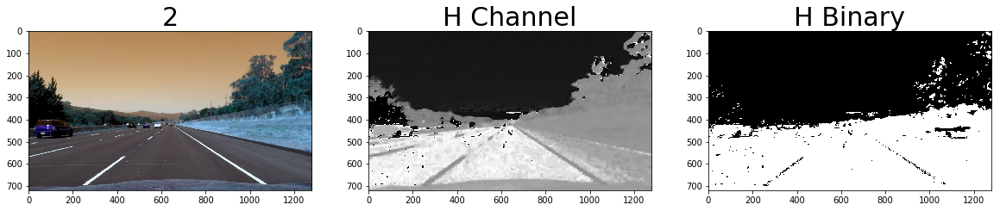

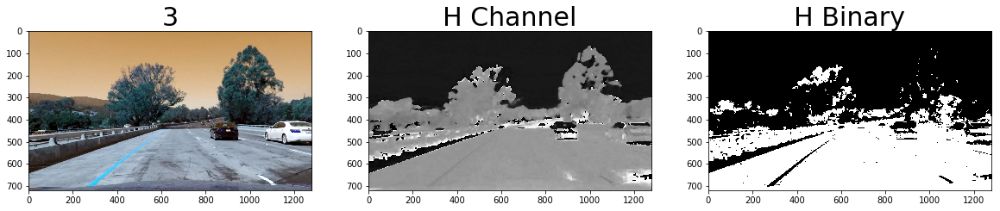

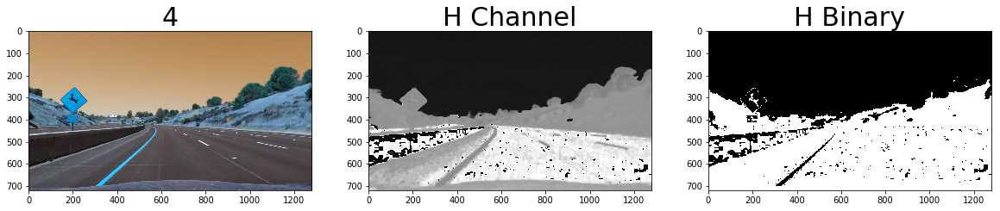

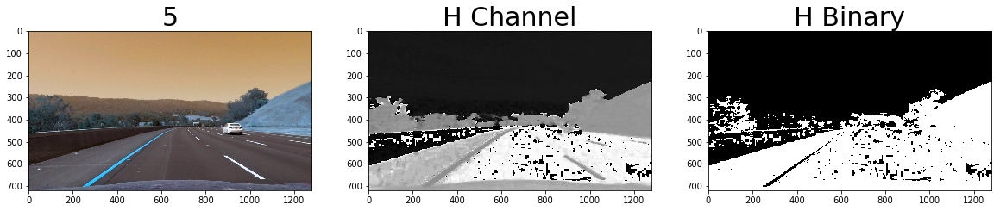

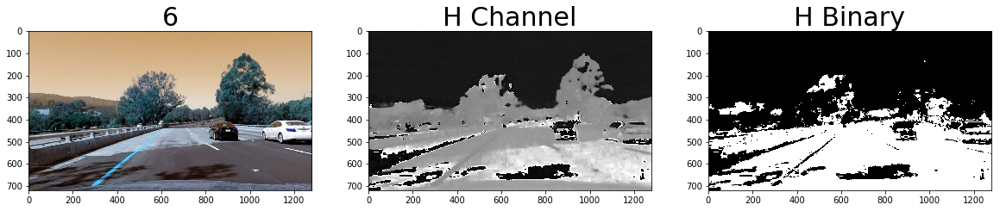

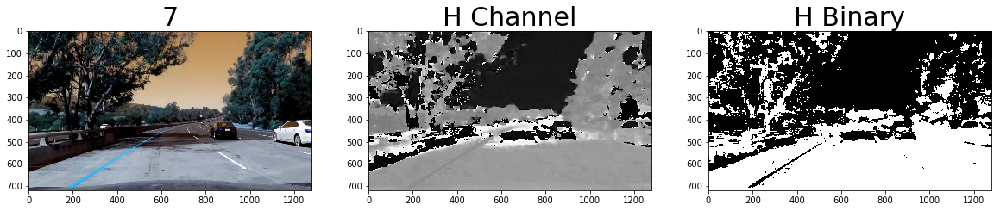

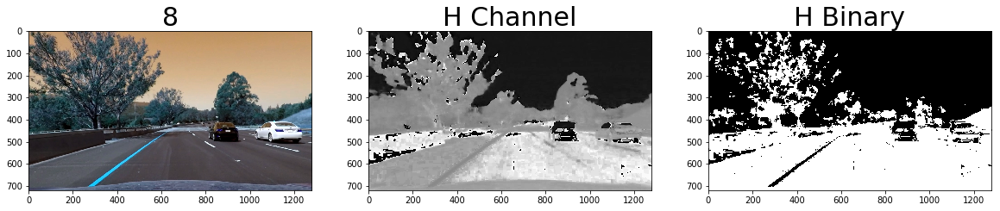

In [15]:
# Test on H_channel
for idx, dst in enumerate(test_dst_images):
    hls = cv2.cvtColor(dst, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    h_binary = channel_select(H, thresh=(100, 255))
    if debug:
        show3images(dst, idx + 1, H, "H Channel", h_binary, "H Binary")
print('Done')    

Done


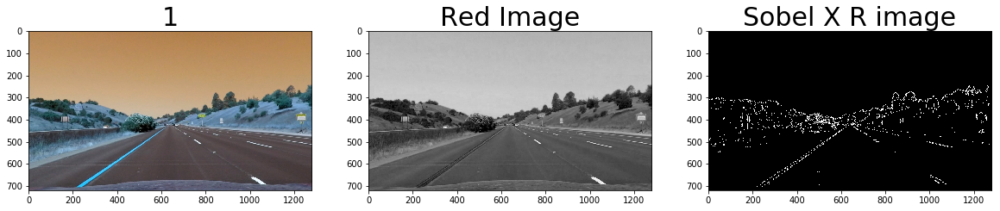

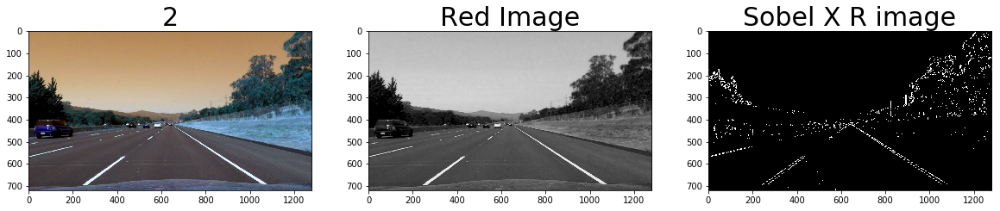

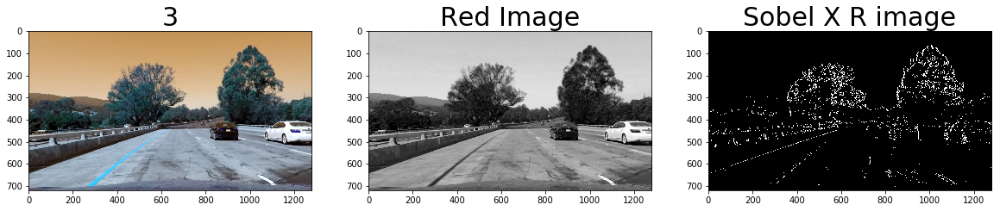

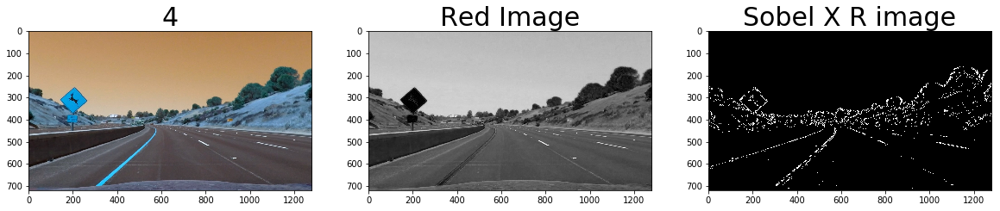

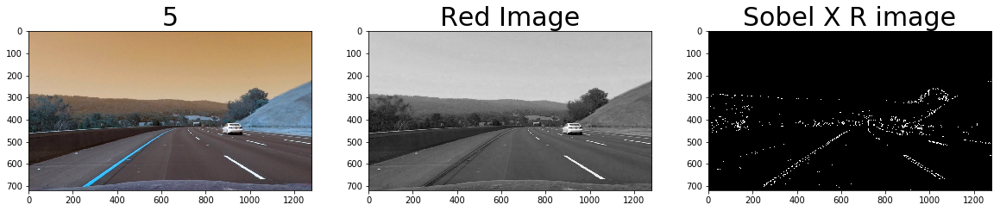

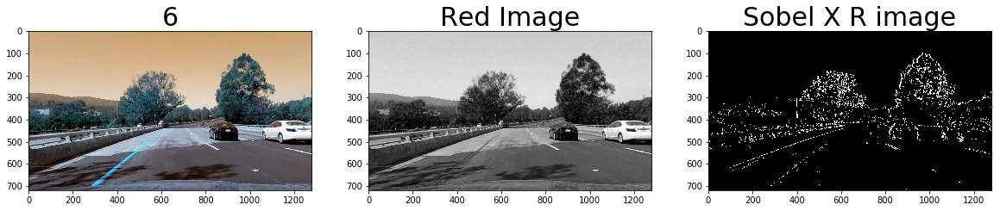

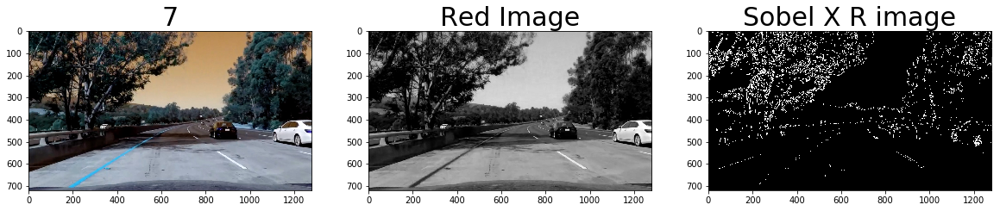

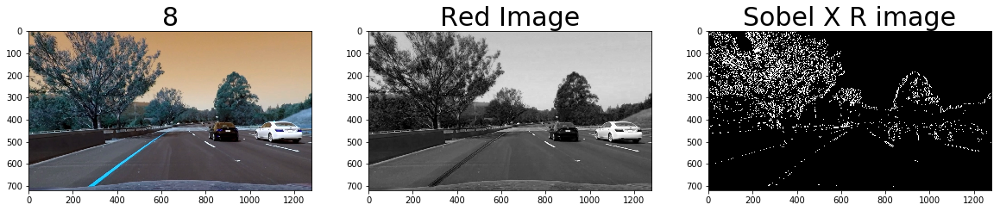

In [16]:
# try abs_sobel_thresh with red channel
for idx, dst in enumerate(test_dst_images):
    R = dst[:,:,0]
    abs_sobel_img = abs_sobel_thresh(R, orient='x', thresh_min=30, thresh_max=100)
    if debug:
        show3images(dst, idx + 1, R, 'Red Image', abs_sobel_img, 'Sobel X R image')
print('Done')    

Applying threshold on the R (red) channel gives a bad output with some lines missing on image 1, 4, 5, 6, 7, 8 and a lot of noise on image 3, 6 and 7.

Done


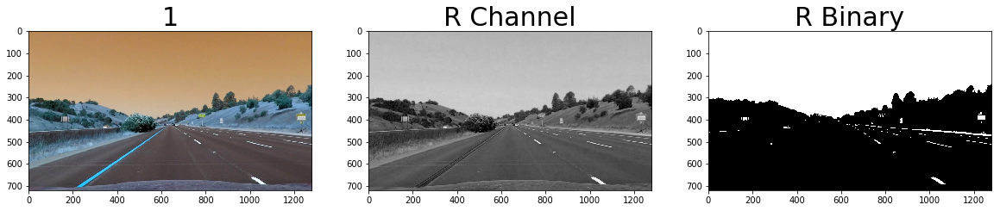

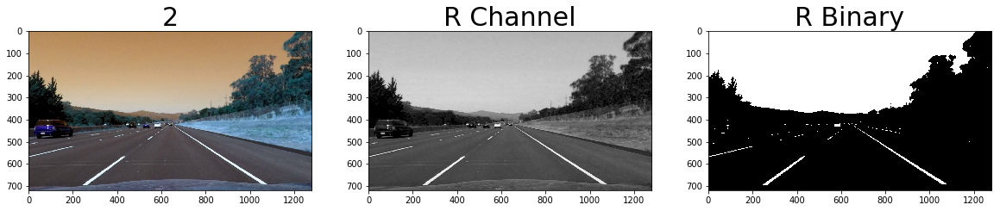

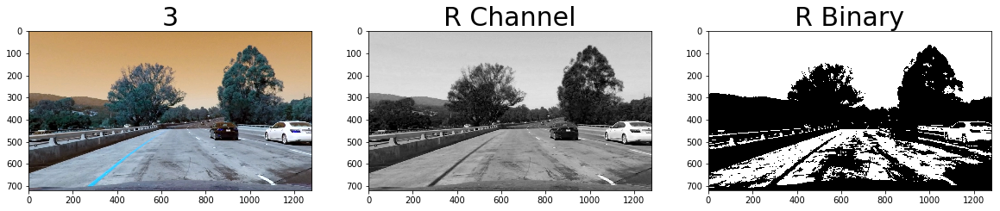

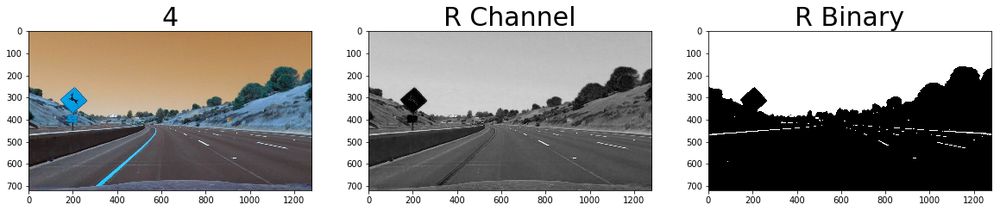

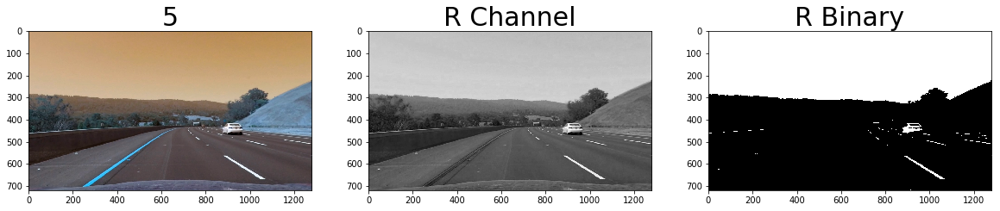

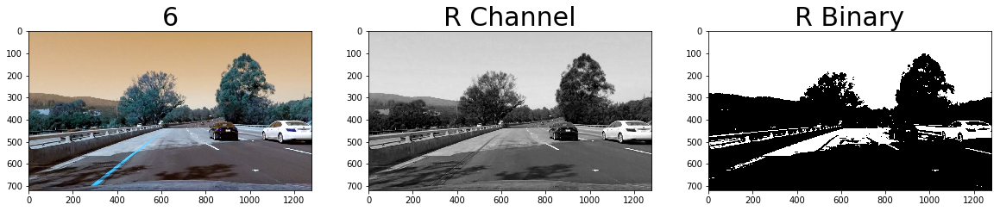

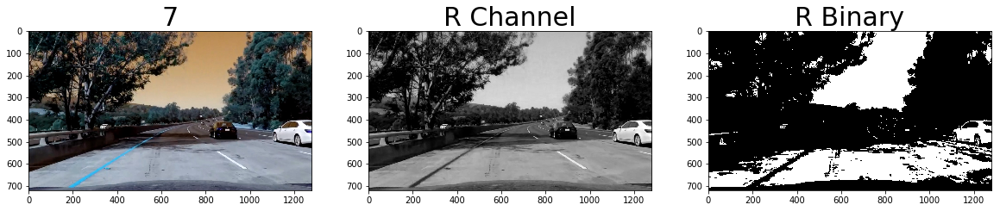

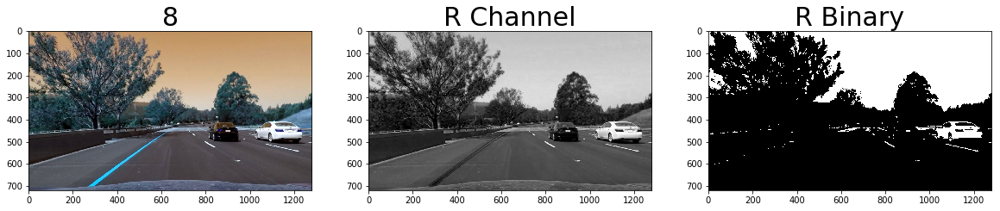

In [17]:
# Select on R channel
for idx, dst in enumerate(test_dst_images):
    R = dst[:,:,0]
    r_binary = channel_select(R, thresh=(150, 255))
    if debug:
        show3images(dst, idx + 1, R, "R Channel", r_binary, "R Binary")
print('Done')    

### Combine color and threshold together

From the abobe results, I have realized that I can combine the output of the sobel threahold x direction and the S (saturation) channel color threshold together in order to get the expected result. The lines are detected well on both dashed and solid lines and it also work well on the bright condition.

Done


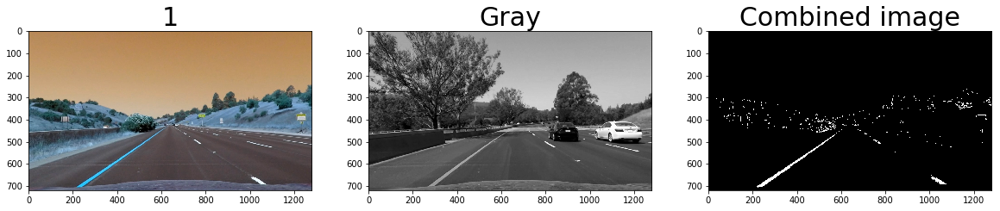

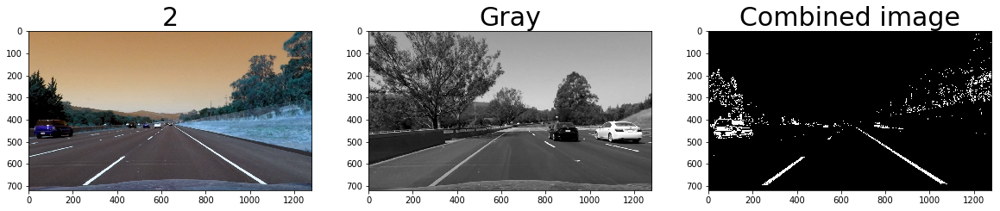

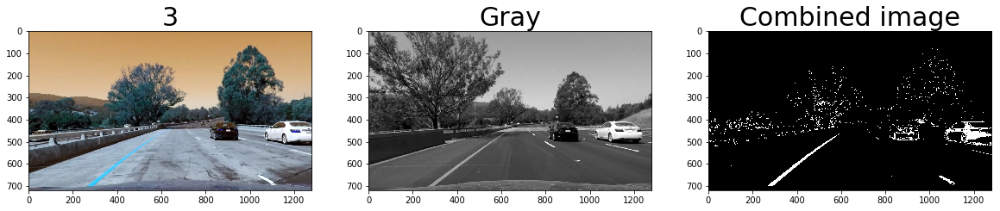

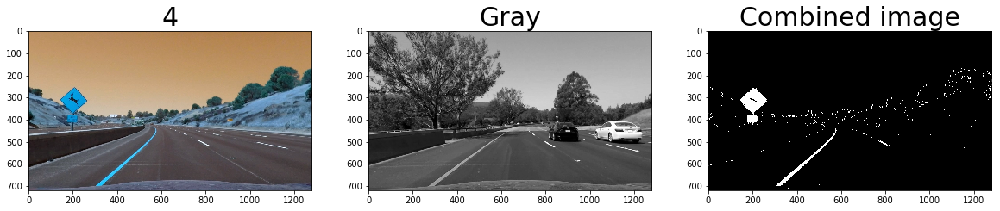

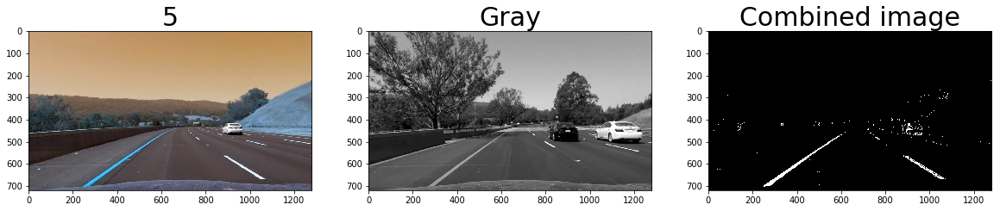

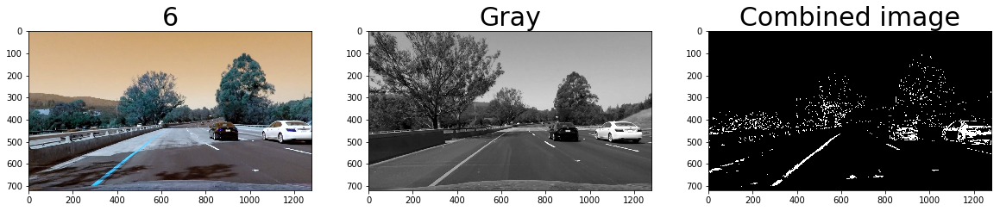

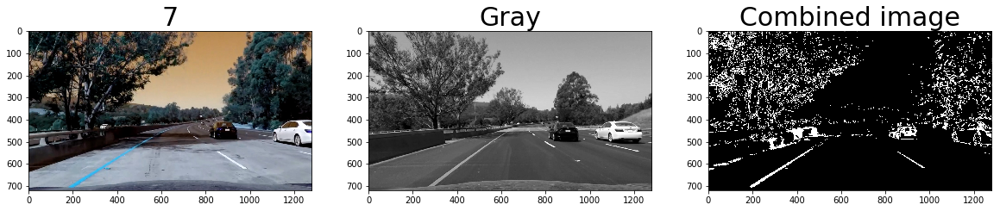

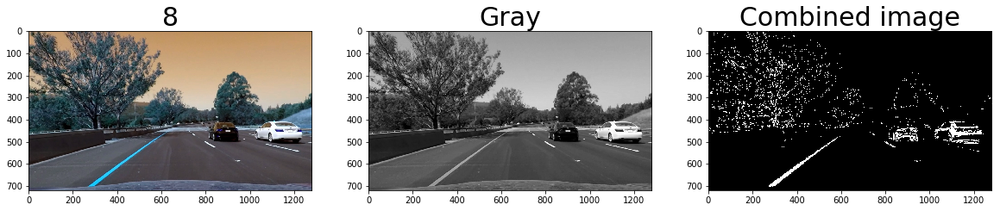

In [19]:
# Try to combine
# S = hls[:,:,2]
# s_binary = channel_select(S, thresh=(100, 255))
# clear on the left lane (smooth)
# not good on the right lane
# OR abs_sobel_img = abs_sobel_thresh(gray, orient='x', thresh_min=30, thresh_max=100)
# Combine thresholds

def combine1(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #gradx = abs_sobel_thresh(gray, orient='x', thresh_min=30, thresh_max=100)
    gradx = abs_sobel_thresh(gray, orient='x', thresh_min=60, thresh_max=255)
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    s_binary = channel_select(S, thresh=(150, 255))
    #s_binary = channel_select(S, thresh=(120, 255))
    
    combined = np.zeros_like(s_binary)
    #combined[((gradx == 1) & (grady == 1)) & ((mag_binary == 1) & (dir_binary == 1))] = 1
    #combined[((gradx == 1) & (dir_binary == 1)) | ((mag_binary == 1) & (grady == 1))] = 1
    combined[((gradx == 1) | (s_binary == 1))] = 1
    return combined
for idx, dst in enumerate(test_dst_images):
    combined = combine1(dst)
    #combined[((gradx == 1) | ((dir_binary == 1) & (mag_binary == 1)))] = 1
    if debug:
        show3images(dst, idx + 1, gray, 'Gray', combined, 'Combined image')
print('Done')    

I also try the combination approach that mentioned in the Udacity lession and the result is also good. Finally, I choose my combination approach with only the sobel threshold and S channel color threshold because it is simpler and good enough to detect lines in test examples.

Done


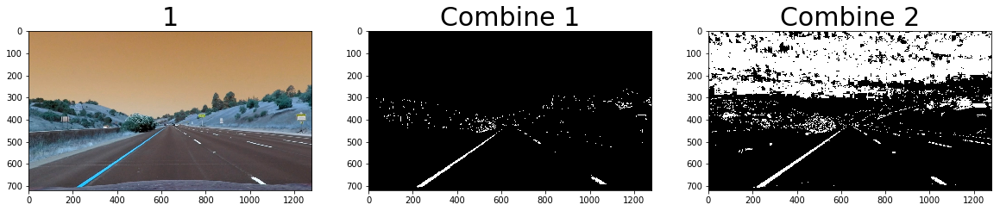

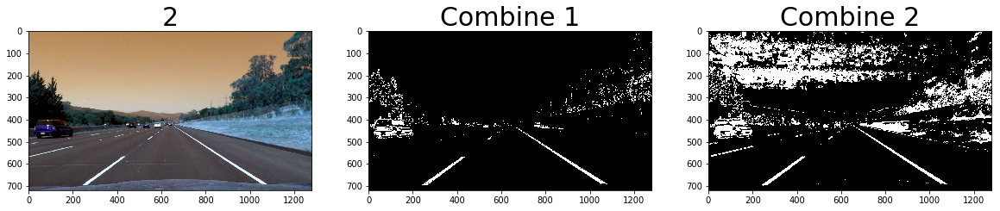

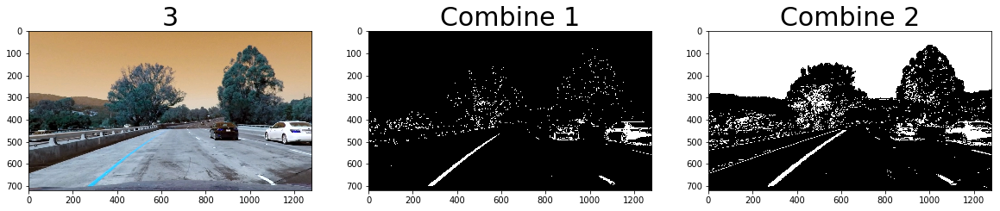

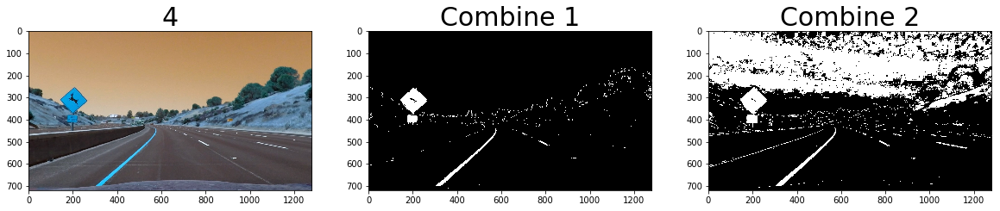

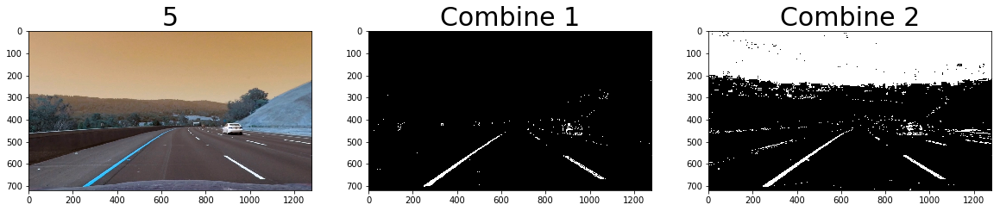

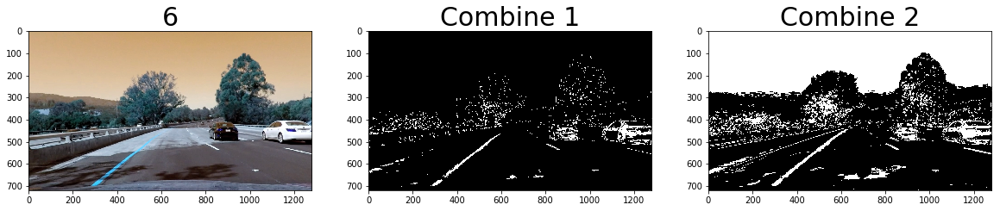

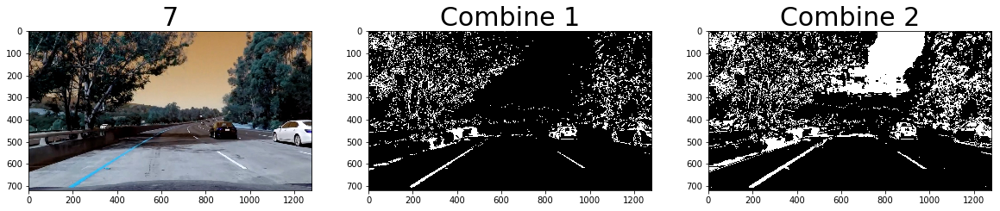

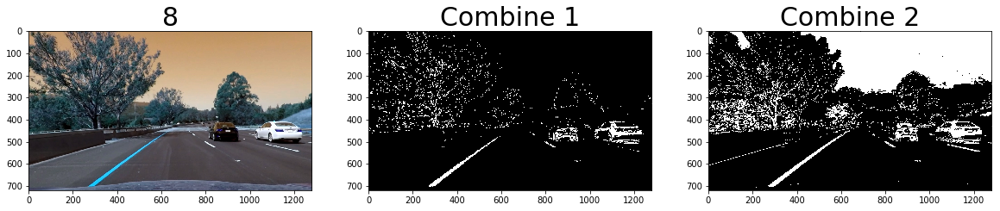

In [20]:
def combine2(img, ksize = 15):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gradx = abs_sobel_thresh(gray, orient='x', thresh_min=10, thresh_max=255)
    grady = abs_sobel_thresh(gray, orient='y', thresh_min=60, thresh_max=255)
    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(60, 255))
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(0.65, 1.05))
    
    #gradx = abs_sobel_thresh(gray, orient='x', thresh_min=30, thresh_max=100)
    #grady = abs_sobel_thresh(gray, orient='y', thresh_min=30, thresh_max=100)
    #mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(30, 100))
    #dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(0.6, 1.3))
    
    
    thresold = np.zeros_like(dir_binary)
    thresold[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    s_binary = channel_select(S, thresh=(100, 255))
    
    combined = np.zeros_like(s_binary)
    combined[((thresold == 1) | (s_binary == 1))] = 1
    return combined

for idx, dst in enumerate(test_dst_images):
    combined2 = combine2(dst)
    combined1 = combine1(dst)
    if debug:
        show3images(dst, idx + 1, combined1, 'Combine 1', combined2, 'Combine 2')
print('Done')    

### Region of Interest

Following the project 1, I also crop the input image in order to filter out some noises such as skyline, other cars, trees, etc...

Done


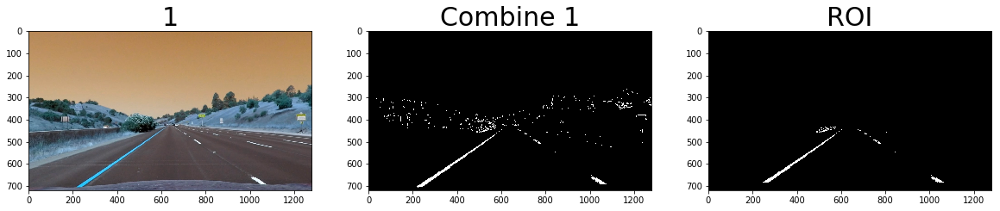

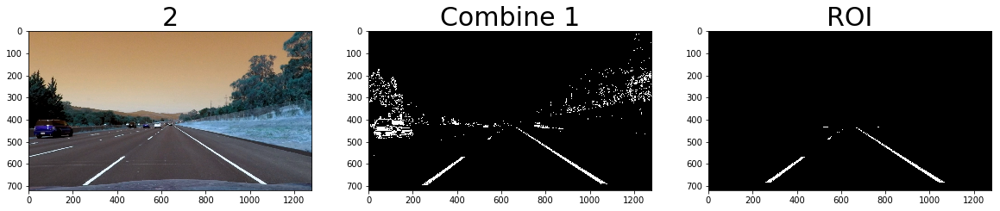

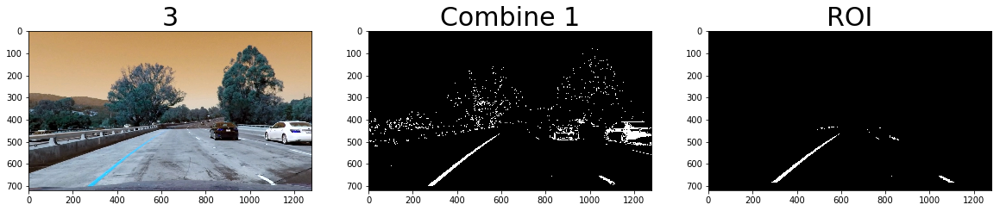

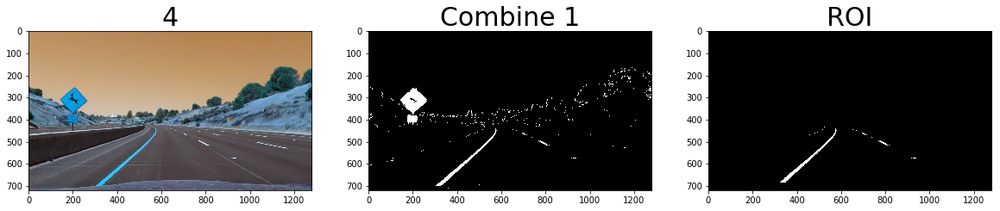

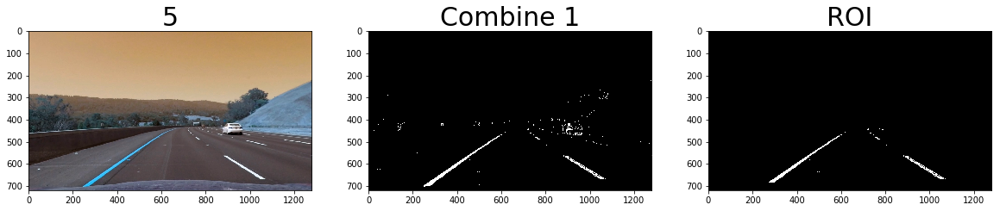

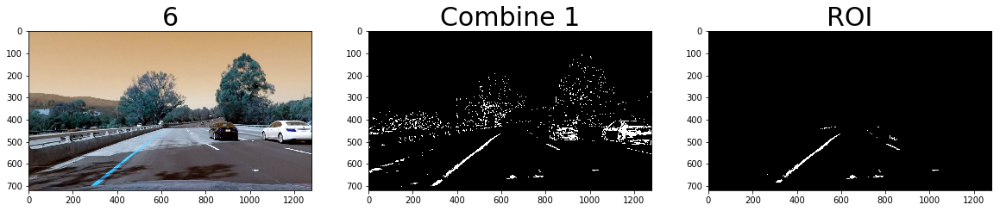

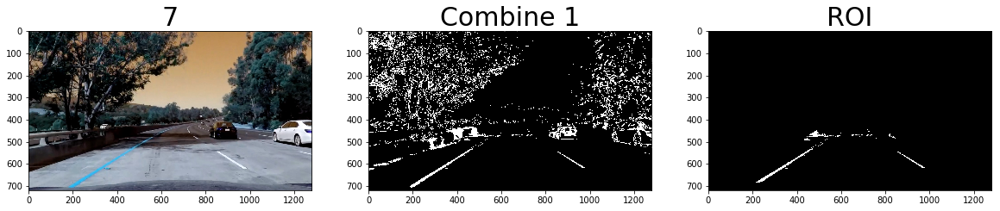

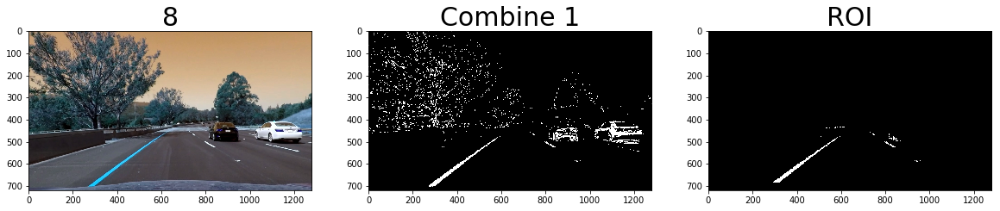

In [21]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


# define the region of interest vertices based on image size
def calculate_roi(img):
    rows, cols = img.shape[:2]
    # 1280 - 720
    p1 = [cols*0.1, rows*0.95]
    p2 = [cols*0.4, rows*0.6]
    p3 = [cols*0.6, rows*0.6] 
    p4 = [cols*0.9, rows*0.95]
    vertices = np.array([[p1, p2, p3, p4]], dtype=np.int32)
    return vertices

for idx, dst in enumerate(test_dst_images):
    combined1 = combine1(dst)
    roi_img = region_of_interest(combined1, calculate_roi(combined1))
    if debug:
        show3images(dst, idx + 1, combined1, 'Combine 1', roi_img, 'ROI')
print('Done')    

## Step 4 Perspective Transform

The purpose of this step is transforming the image to the birds eye view in oder to fit a curve on the lane easier. I manually choose the 4 source points that similiar to the region of masking. And I choose the 4 destination points that will transform the source points to the birds view eye. I use the cv2.getPerspectiveTransform() to get the transformation matrix and use it for transform image by the cv2.warpPerspective() function. I also get the revert transformation matrix to revert the warped image to the original image after fit the lane line poly.

Done


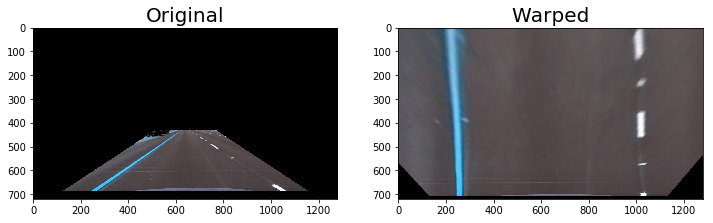

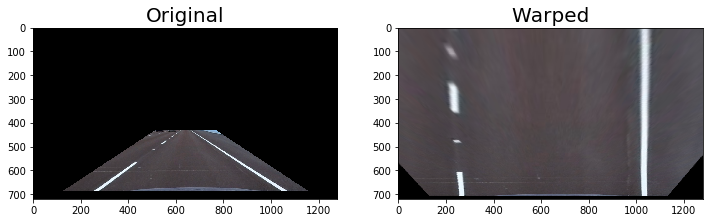

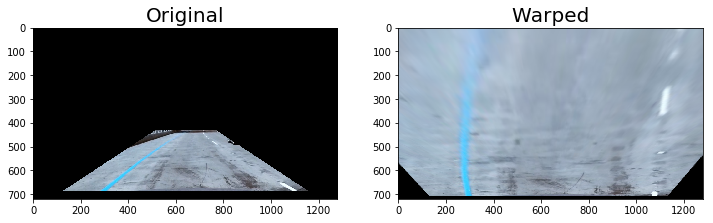

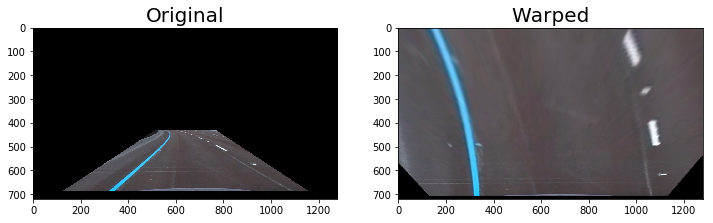

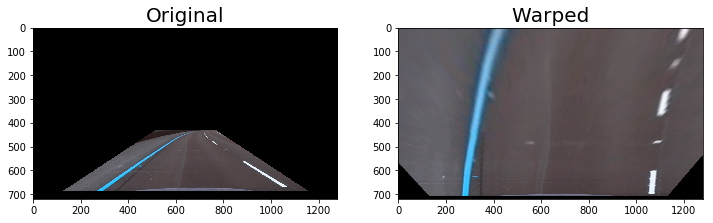

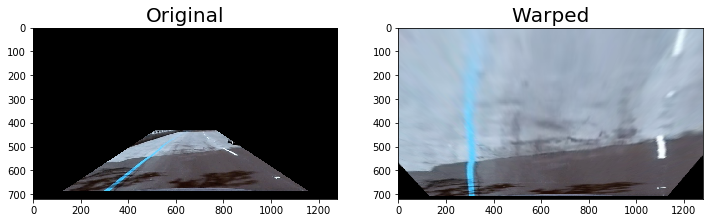

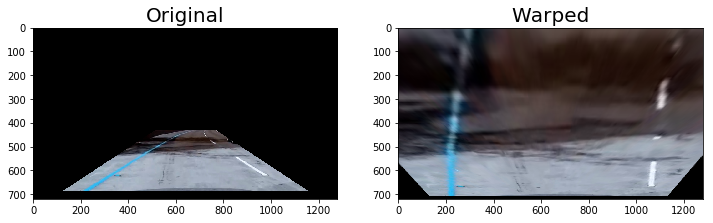

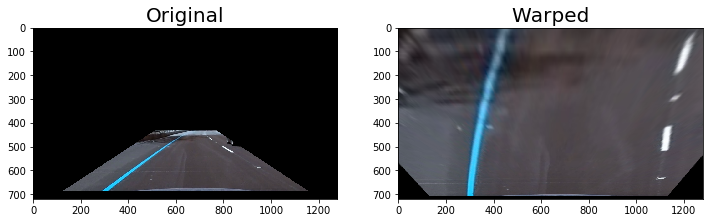

In [22]:
def warp(img):
    #img_size = (img.shape[1], img.shape[0])
    #src = np.float32([[595, 450],[695,450],[1045,675],[260,680]])
    #dst = np.float32([[335,95],[1120,95],[1045,675],[260,680]])
    img_size = (img.shape[0], img.shape[1])
    offset = 210
    img_size = (img.shape[1], img.shape[0])
    src = np.float32([[150 + 430, 460], [1150 - 440, 460], [1150, 720], [150, 720]])
    dst = np.float32([[offset, 0], [img_size[0]-offset, 0], [img_size[0]-offset, img_size[1]], [offset, img_size[1]]])
    #img_size = (img.shape[1], 223)
    #src = np.float32([[0, 673], [1207, 673], [0, 450], [1280, 450]])
    #dst = np.float32([[569, 223], [711, 223], [0, 0], [1280, 0]])
    
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size)
    
    return warped, M, Minv

def show_warped(img1, warped):
    f, (plot1, plot2) = plt.subplots(1, 2, figsize=(12, 7))
    plot1.imshow(img1)
    plot1.set_title('Original', fontsize=20)
    plot2.imshow(warped)
    plot2.set_title('Warped', fontsize=20)


for idx, dst in enumerate(test_dst_images):
    roi_img = region_of_interest(dst, calculate_roi(dst))
    warped, M, Minv = warp(roi_img)
    if debug:
        show_warped(roi_img, warped)
print('Done')

Done


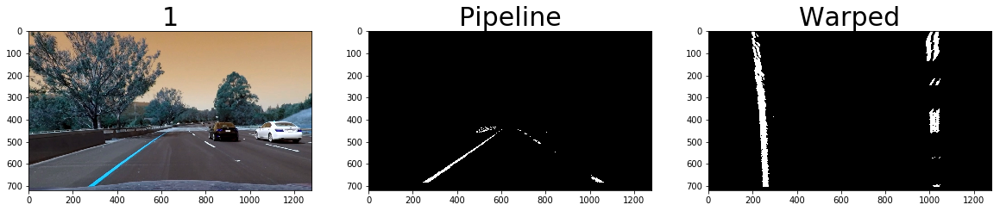

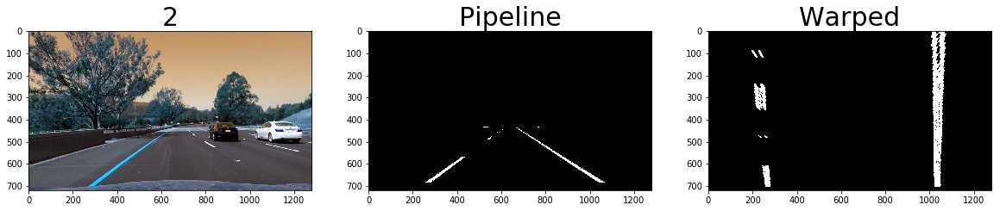

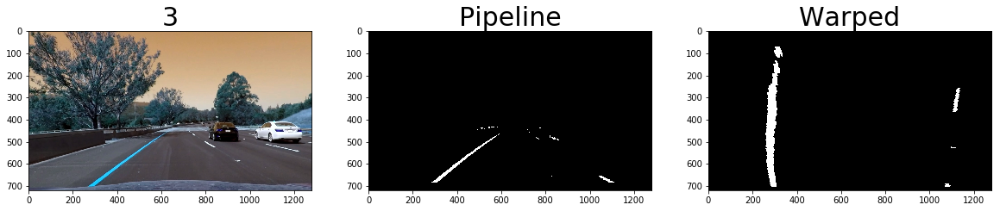

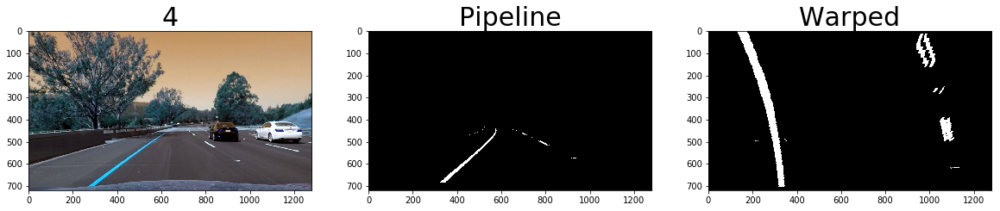

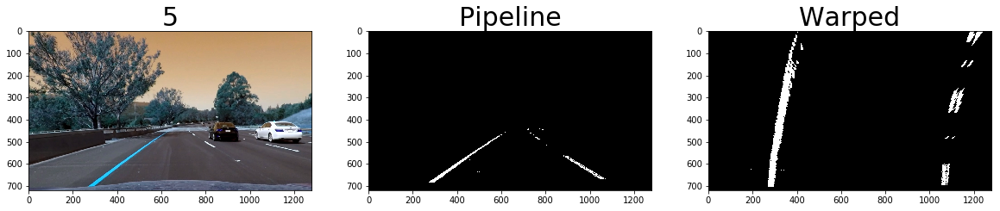

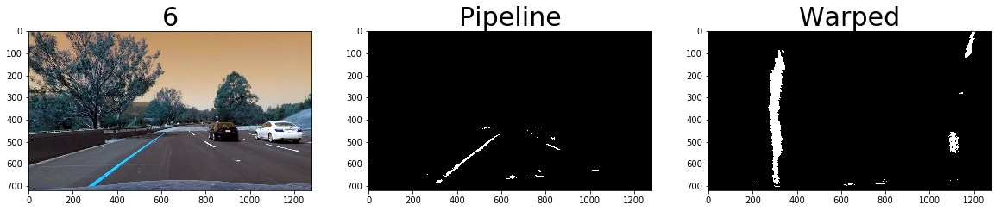

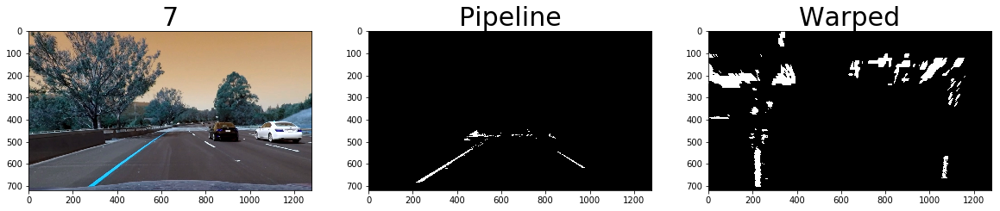

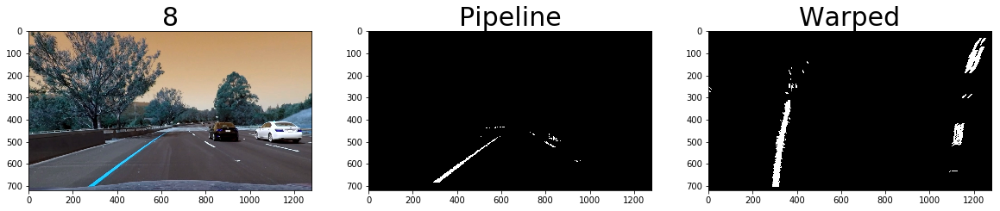

In [23]:
debug = True
def pipeline(img):
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    combined1 = combine1(dst)
    roi_img = region_of_interest(combined1, calculate_roi(combined1))
    return roi_img
for idx, img in enumerate(test_images):
    pine_img = pipeline(img)
    warped, M, Minv = warp(pine_img)
    if debug:
        show3images(dst, idx + 1, pine_img, 'Pipeline', warped, 'Warped')
print('Done')

## Step 5 Finding lane lines

### Define the Line and Lane classes

The Line class use to store the properties of each line detection such as the x, y points, the curvature and the line fit.

In [26]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
print('Done')

Done


The Lane class stores the lane detection properties: left line and right line.

In [27]:
# Define a class for each Lane detection
class Lane():
    def __init__(self):
        # was the lane detected in the last iteration?
        self.detected = False
        # the left line
        self.left_line = None
        # the right line
        self.right_line = None
print('Done')          

Done


### Find lane using the sliding windows

Based on the histogram of the warped image, I can find the left and right x base points. From these points, I use the sliding windows to move up in order to find the line pixels within the sliding window.

In [24]:
# nwindows - the number of sliding windows
# margin - the margin width of the windows
# minpix - the minimun pixels found to recenter window
def find_lanes(warped, nwindows=9, margin=100, minpix=50):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(warped[warped.shape[0]//2:,:], axis=0)
    
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Set height of sliding windows
    window_height = np.int(warped.shape[0]/nwindows)
    
    # Identity the x and y positions of all nonzero pixels in the image
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows on by one
    for window in range(nwindows):
        # Identify the window boundaries in x and y (and left and right)
        win_y_low = warped.shape[0] - (window+1)*window_height
        win_y_high = win_y_low + window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Identify the nonzero pixels in x and y within the window
        #good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        #(nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                         & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                          & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # if you found > minpix pixels, recenter next window on their mean position
        if (len(good_left_inds) > minpix):
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if (len(good_right_inds) > minpix):
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right lane pixel positions
    leftx =  nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_line = Line()
    
    right_line = Line()
    
    if ((leftx.size > 0) and (lefty.size > 0)):
    # Fit a second order polynomiral to each
        left_fit = np.polyfit(lefty, leftx, 2)
        left_line.detected = True
    else:
        left_fit = None
        left_line.detected = False
    if ((rightx.size > 0) and (righty.size > 0)):
        right_fit = np.polyfit(righty, rightx, 2)
        right_line.detected = True
    else:
        right_fit = None
        right_line.detected = False
    
    
    left_line.allx = leftx
    left_line.ally = lefty
    left_line.current_fit = left_fit
    
    
    
    right_line.allx = rightx
    right_line.ally = righty
    right_line.current_fit = right_fit
    
    
    lane = Lane()
    lane.detected = (left_line.detected and right_line.detected)
    lane.left_line = left_line
    lane.right_line = right_line
    return lane

print('Done')    

Done


I try to test the find_lanes() function with the test images and the result is expected.

Done


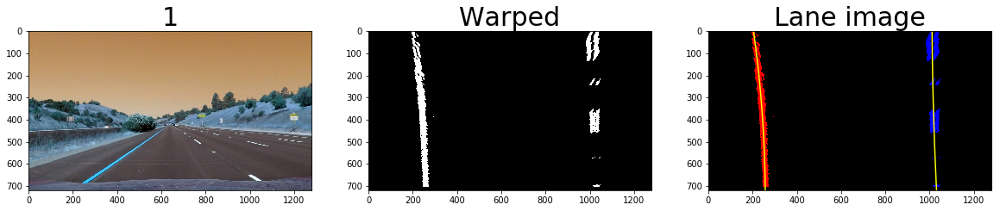

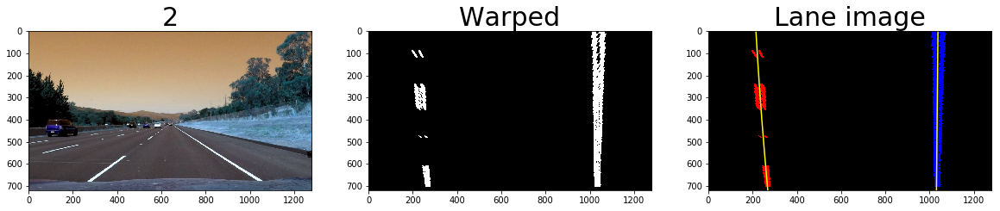

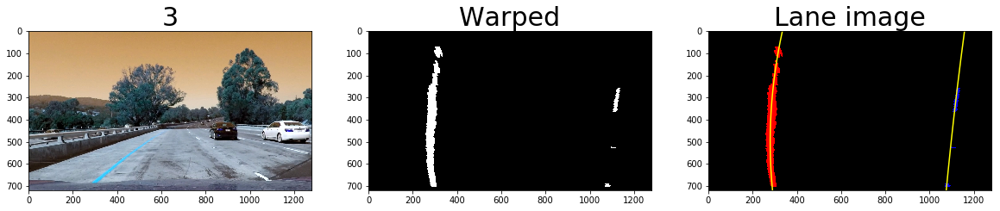

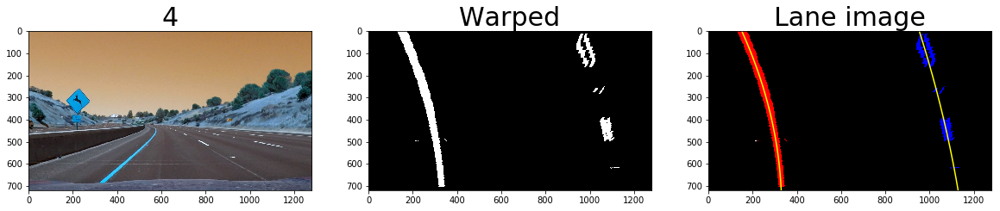

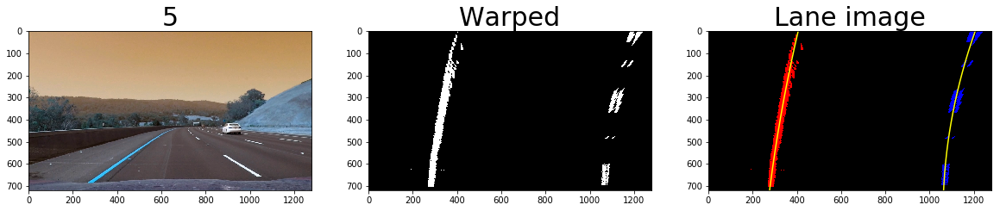

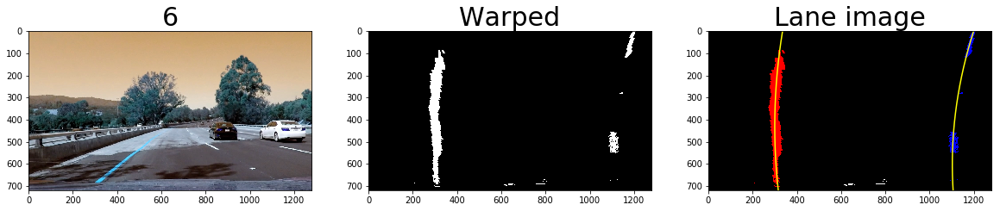

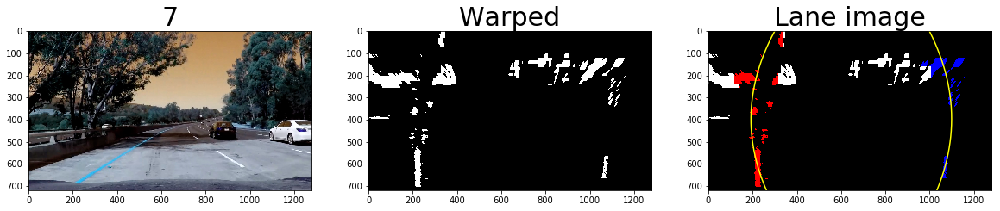

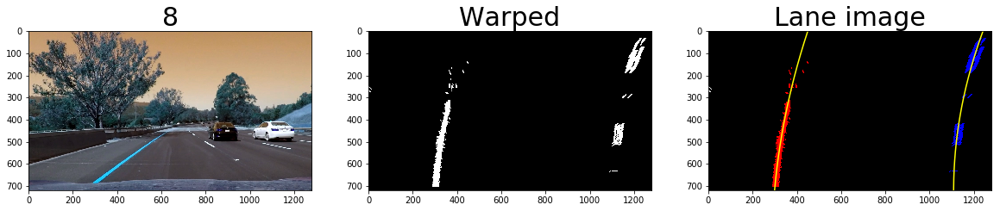

In [28]:
# Visual the found lane lines for testing
def visual_lanes(warped):
    
    lane = find_lanes(warped, nwindows=9, margin=100, minpix=50)
    left_line = lane.left_line
    right_line = lane.right_line
    
    left_fit = left_line.current_fit
    right_fit = right_line.current_fit
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    out_img = np.dstack((warped, warped, warped)) * 255
    
    out_img[left_line.ally, left_line.allx] = [255,0,0]
    out_img[right_line.ally, right_line.allx] = [0,0,255]
 
    return out_img, left_fitx, right_fitx
def show_lane_images(image1, title1, image2, title2, image3, title3, left_fitx, right_fitx):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))
    if (len(image1.shape) == 2):
        ax1.imshow(image1, cmap = 'gray')
    else:
        ax1.imshow(image1)
    ax1.set_title(title1, fontsize=30)
    if (len(image2.shape) == 2):
        ax2.imshow(image2, cmap = 'gray')
    else:
        ax2.imshow(image2)
    ax2.set_title(title2, fontsize=30)
    if (len(image3.shape) == 2):
        ax3.imshow(image3, cmap = 'gray')
    else:
        ax3.imshow(image3)
    ploty = np.linspace(0, image3.shape[0]-1, image3.shape[0])
    ax3.plot(left_fitx, ploty, color="yellow")
    ax3.plot(right_fitx, ploty, color="yellow")
    ax3.set_title(title3, fontsize=30)
    
for idx, img in enumerate(test_images):
    pine_img = pipeline(img)
    warped, M, Minv = warp(pine_img)
    out_img, left_fitx, right_fitx = visual_lanes(warped)
    if debug:
        show_lane_images(img, idx + 1, warped, 'Warped', out_img, 'Lane image', left_fitx, right_fitx)

print('Done')    

### Find lanes from previous frame lane

Finding lane with the sliding windows algorithm can work well. However, it cost time to execute. It's easy to regconize that the lanes are not much different between 2 next frames. So, I implement the find lane from previous lane function following the Udacity code on lession. 

In [29]:
def find_lanes_from_previous(warped, lane, margin=100):
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_fit = lane.left_line.current_fit
    right_fit = lane.right_line.current_fit
    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Extract left and right line pixels positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_line = Line()
    right_line = Line()
    
    # Fit the second order polynomial to each
    if (leftx.size > 0 and lefty.size > 0):
        left_fit = np.polyfit(lefty, leftx, 2)
        left_line.detected = True
    else:
        left_fit = None
        left_line.detected = False
        if debug:
            print('Cannot detect left line')
    if (rightx.size > 0 and righty.size > 0):
        right_fit = np.polyfit(righty, rightx, 2)
        right_line.detected = True
    else:
        right_fit = None
        right_line.detected = False
        if debug:
            print('Cannot detect right line')
    
    
    
    left_line.allx = leftx
    left_line.ally = lefty
    left_line.current_fit = left_fit
    
    right_line.allx = rightx
    right_line.ally = righty
    right_line.current_fit = right_fit
    
    current_lane = Lane()
    current_lane.detected = (left_line.detected and right_line.detected)
    current_lane.left_line = left_line
    current_lane.right_line = right_line
    return current_lane

print('Done')    

Done


## Step 6 Calculate the curvature and the position of the vehicle

Following [the avesome tutorial](http://www.intmath.com/applications-differentiation/8-radius-curvature.php) and the Udacity lession, I can implement a function to calculate the radius of curvature of the lane. I also assume that the lane is about 30 meters long and 3.7 meters wide in order to convert the radius of curvature in pixels to meters.
I assume that the car always on the center of the lane, so I can calculate the car position by the average of left and right x bottom points. I convert the car position pixel value to meter with the same 3.7 meters wide assumption.

In [30]:
# ym_per_pix - meters per pixel in y dimension
# xm_per_pix - meters per pixel in x dimension
def cal_curvature(warped, lane, ym_per_pix = 30/720, xm_per_pix = 3.7/800):
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
    y_eval = np.max(ploty)
    leftx = lane.left_line.allx
    lefty = lane.left_line.ally
    
    rightx = lane.right_line.allx
    righty = lane.right_line.ally
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    left_curverad, right_curverad = (0,0)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    return left_curverad, right_curverad

def cal_distance(warped, lane, xm_per_pix = 3.7/800):
    h = warped.shape[0]
    left_fit_x_int = lane.left_line.current_fit[0]*h**2 + lane.left_line.current_fit[1]*h + lane.left_line.current_fit[2]
    right_fit_x_int = lane.right_line.current_fit[0]*h**2 + lane.right_line.current_fit[1]*h + lane.right_line.current_fit[2]
    lane_center_position = (left_fit_x_int + right_fit_x_int) / 2
    
    car_position = warped.shape[1]/2
    center_dist = (car_position - lane_center_position) * xm_per_pix
    return center_dist

for idx, img in enumerate(test_images):
    pine_img = pipeline(img)
    warped, M, Minv = warp(pine_img)
    lane = find_lanes(warped, nwindows=9, margin=100, minpix=50)
    left_curverad, right_curverad = cal_curvature(warped, lane)
    lane.left_line.radius_of_curvature = left_curverad
    lane.right_line.radius_of_curvature = right_curverad
    center_dist = cal_distance(warped, lane)
    print(idx + 1, left_curverad, right_curverad, center_dist)
print('Done')    

1 2041.73178166 6477.14702194 -0.0197660006616
2 7670.77096041 1112896.31771 -0.0459548645873
3 857.096747138 6991.57424326 -0.197267169352
4 667.183040649 1836.52787934 -0.41202246324
5 2513.48025219 882.092223573 -0.139344163318
6 989.014772415 709.630916814 -0.329224520002
7 278.561854507 296.231597245 -0.0358825524387
8 1122.824464 736.141794218 -0.296234151911
Done


## Putting together - the image processing pipeline

### Define the draw lane function

In [31]:
# The draw lane function: Draw the found lane into the original image
# Minv: The inverted transformation matrix that return from the warped function.
def draw_Lane(warped, lane, Minv, image):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    left_fit = lane.left_line.current_fit
    right_fit = lane.right_line.current_fit
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    return result

# Draw the curvature and distance into the original image
def draw_curv_dist(img, curv, dist):
    text = 'Curvature radius: ' + '{:04.2f}'.format(curv) + 'm'
    cv2.putText(img, text, (40,70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (200,255,155), 2, cv2.LINE_AA)
    
    direction = ''
    if dist > 0:
        direction = 'right'
    elif dist < 0:
        direction = 'left'
    abs_dist = abs(dist)
    text = '{:04.3f}'.format(abs_dist) + 'm ' + direction + ' of center'
    cv2.putText(img, text, (40,120), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return img
    
print('Done')       
    

Done


### Test the pipeline on the test images

Done


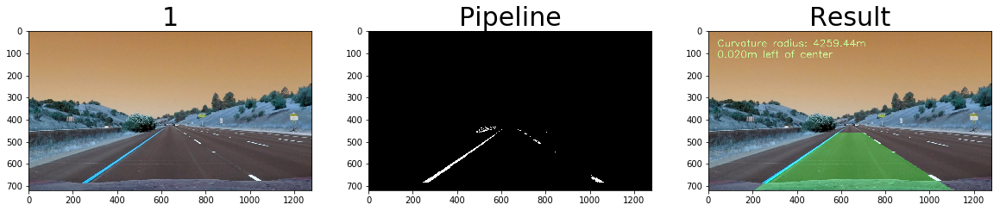

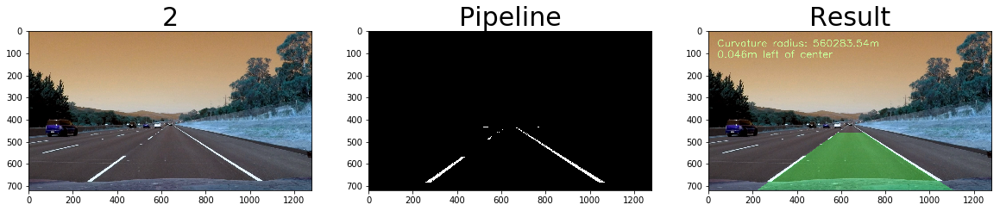

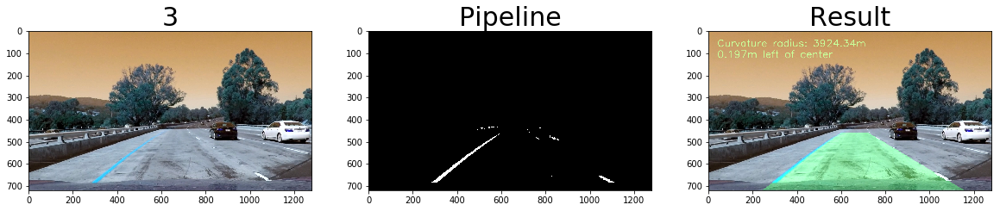

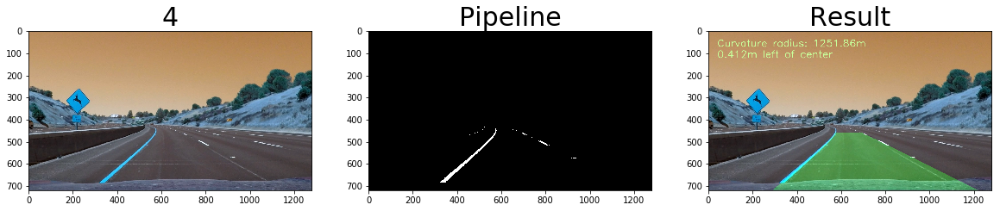

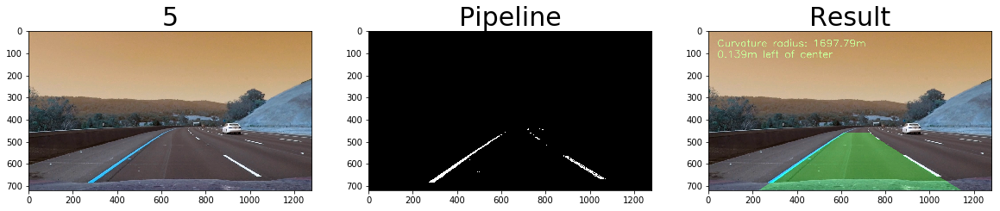

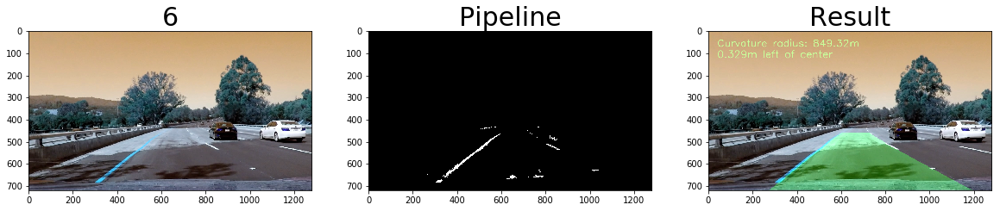

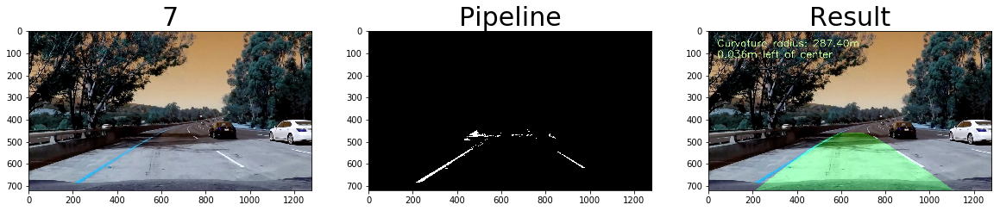

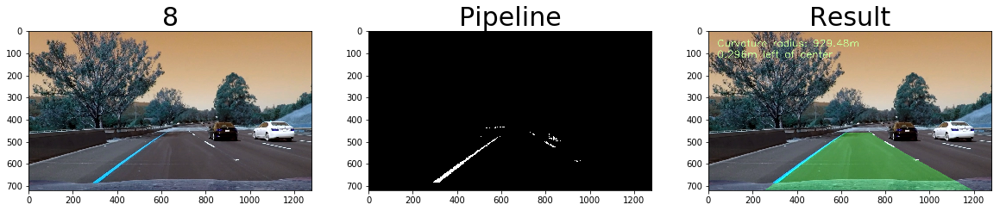

In [32]:
for idx, img in enumerate(test_images):
    pine_img = pipeline(img)
    warped, M, Minv = warp(pine_img)
    lane = find_lanes(warped, nwindows=9, margin=100, minpix=50)
    left_curverad, right_curverad = cal_curvature(warped, lane)
    center_dist = cal_distance(warped, lane)
    curvered = (left_curverad + right_curverad) / 2
    result = draw_Lane(warped, lane, Minv, img)
    final = draw_curv_dist(result, curvered, center_dist)
    if debug:
        show3images(img, idx + 1, pine_img, 'Pipeline', final, 'Result')
print('Done')    

## Step 7 Video processing

### Implement the sanity check function

In order to evaluate the found lane is good enough, I implement the sanity check function with do the following checks: check the distance between 2 left and right lines and check these two lines are roughly parallel.

In [33]:
import math
# Test distance from left line and right line
# The distance horizontally between left line and right line should be about 800 +- 100 pixels
def test_distance(warped, lane):
    h = warped.shape[0]
    left_fit_x_int = lane.left_line.current_fit[0]*h**2 + lane.left_line.current_fit[1]*h + lane.left_line.current_fit[2]
    right_fit_x_int = lane.right_line.current_fit[0]*h**2 + lane.right_line.current_fit[1]*h + lane.right_line.current_fit[2]
    
    x_int_diff = abs(right_fit_x_int - left_fit_x_int)
    if (abs(x_int_diff - 800) > 100):
        if debug:
            print('Test distance failure: ', x_int_diff)
        return False
    else:
        return True
def test_with_previous_lane(warped, previous_lane, lane):
    h = warped.shape[0]
    delta_left = math.fabs(lane.left_line.allx[h-1] - previous_lane.left_line.allx[h-1])
    if delta_left > 5:
        if debug:
            print('delta left failure', delta_left)
        return False
    delta_right = math.fabs(lane.right_line.allx[h-1] - previous_lane.right_line.allx[h-1])
    if delta_right > 5:
        return False
    return True

# Test to check the left line and right line are roughly parallel
def test_parallel(warped, lane):
    top = 4
    bottom = warped.shape[0]
    middle = bottom//2
    
    left_fit = lane.left_line.current_fit
    right_fit = lane.right_line.current_fit
    left_fit_x_bottom_int = left_fit[0]*bottom**2 + left_fit[1]*bottom + left_fit[2]
    right_fit_x_bottom_int = right_fit[0]*bottom**2 + right_fit[1]*bottom + right_fit[2]
    
    left_fit_x_top_int = left_fit[0]*top**2 + left_fit[1]*top + left_fit[2]
    right_fit_x_top_int = right_fit[0]*top**2 + right_fit[1]*top + right_fit[2]
    
    left_fit_x_middle_int = left_fit[0]*middle**2 + left_fit[1]*middle + left_fit[2]
    right_fit_x_middle_int = right_fit[0]*middle**2 + right_fit[1]*middle + right_fit[2]
    
    x_int_bottom_diff = abs(right_fit_x_bottom_int - left_fit_x_bottom_int)
    x_int_top_diff = abs(right_fit_x_top_int - left_fit_x_top_int)
    x_int_middle_diff = abs(right_fit_x_middle_int - left_fit_x_middle_int)
    
    
    if (abs(x_int_bottom_diff - x_int_top_diff) > 100) or (abs(x_int_top_diff - x_int_middle_diff) > 100) or (abs(x_int_bottom_diff - x_int_middle_diff) > 100):
        if debug:
            print('Test parallel failure: ', x_int_bottom_diff, x_int_middle_diff, x_int_top_diff)
        return False
    else:
        if debug:
            print('Test parallel passed: ', x_int_bottom_diff, x_int_middle_diff, x_int_top_diff)
        return True
# Checked whether the found lane is good enough
def sanity_check(warped, previous_lane, lane):
    if (lane.detected == False):
        return False
    # Check the lane distance is enough
    if (test_distance(warped, lane) == False):
        return False
    # Check two left and right line are roughly parallel
    if (test_parallel(warped, lane) == False):
        return False
    
    return True
    
if debug:
    for idx, img in enumerate(test_images):
        pine_img = pipeline(img)
        warped, M, Minv = warp(pine_img)
        lane = find_lanes(warped, nwindows=9, margin=100, minpix=50)
        print(idx + 1)
        sanity_check(warped, lane, lane)

1
Test parallel passed:  774.223953494 774.882313631 806.351306263
2
Test parallel passed:  762.294207743 795.682067998 822.418215453
3
Test parallel passed:  785.210723575 829.113670078 823.545853339
4
Test parallel passed:  799.543588878 777.518475759 801.382925102
5
Test parallel passed:  786.44887824 775.317361808 799.507971394
6
Test parallel passed:  790.255787198 817.188170778 862.859575753
7
Test parallel failure:  770.39133555 905.122874766 704.017239085
8
Test parallel passed:  809.255604409 789.171255224 791.685016766


### The process image function

The process image function process one image from video following the below steps:
* Finding lanes using the sliding windows algorithm for the first frame.
* Finding lanes from the previous found lane for the next frames.
* Do sanity check for the found lane.
* If the sanity check is passed, the lane is good enough and draw to the original image.
* If the sanity check is failed and the number of failure is below the MAXIMUM_FAILURE allowed, the previous lane is used and draw to the original image.
* If the sanity check is failed and the number of failure is above or equal the MAXIMUM_FAILURE allowed, the lane will be found again using the sliding window algorithrm,

In [36]:
from moviepy.editor import VideoFileClip

lane_history = []
last_lane = None
no_of_failure = 0
debug = False

# Process one image
def process_image(img):
    MAXIMUM_FAILURE = 2
    global last_lane
    global no_of_failure
    pine_img = pipeline(img)
    warped, M, Minv = warp(pine_img)
    # It's the first frame - find lane using the sliding windows
    if (last_lane is None):
        if debug:
            print('Find the first frame')
        lane = find_lanes(warped, nwindows=9, margin=100, minpix=50)
    else:
        if debug:
            print('Find from previous frame')
        lane = find_lanes_from_previous(warped, last_lane, margin=100)
    # Go to sanity check
    if (last_lane is None):
        last_lane = lane
    else:
        # Do the sanity check
        if (sanity_check(warped, last_lane, lane) == False):
            no_of_failure += 1
            if debug:
                print('Sanity check failure: ', no_of_failure)
            # Reset - finding again by sliding window if no of failure is over maximum failure allowed.
            if (no_of_failure >= MAXIMUM_FAILURE):
                if debug:
                    print('Reset - find by siding windows')
                lane = find_lanes(warped, nwindows=9, margin=100, minpix=50)
                # Do sanity check again
                if (sanity_check(warped, last_lane, lane) == False):
                    # Use the previous lane if the sanity check still failure
                    lane = last_lane
                    no_of_failure += 1
                else:
                    # Reset the last lane and no of failure
                    last_lane = lane
                    no_of_failure = 0
            else:
                lane = last_lane
        else:
            last_lane = lane
            no_of_failure = 0
    
    # Calculate the curvature of lane  
    left_curverad, right_curverad = cal_curvature(warped, lane)
    # Calculate the car position
    center_dist = cal_distance(warped, lane)
    curvered = (left_curverad + right_curverad) / 2
    # Draw the found lane
    result = draw_Lane(warped, lane, Minv, img)
    # Draw the curvature and position
    final = draw_curv_dist(result, curvered, center_dist)
    return final


### Process the project video

In [37]:
video_input1 = VideoFileClip('project_video.mp4')
video_output = "project_video_outout.mp4"
processed_video = video_input1.fl_image(lambda img:process_image(img))
%time processed_video.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video project_video_outout.mp4
[MoviePy] Writing video project_video_outout.mp4



 10%|████████                                                                       | 129/1261 [00:12<01:45, 10.76it/s]


 20%|███████████████▋                                                               | 251/1261 [00:23<01:36, 10.44it/s]


 29%|██████████████████████▋                                                        | 363/1261 [00:35<01:53,  7.94it/s]


 39%|██████████████████████████████▊                                                | 492/1261 [00:47<01:10, 10.94it/s]


 50%|███████████████████████████████████████▎                                       | 628/1261 [00:59<00:56, 11.18it/s]


 61%|███████████████████████████████████████████████▊                               | 764/1261 [01:11<00:43, 11.30it/s]


 71%|████████████████████████████████████████████████████████▍                      | 900/1261 [01:23<00:31, 11.29it/s]


 82%|████████████████████████████████████████████████████████████████              | 1036/1261 [01:35<00:22, 10.06it/s]


 91%|███████████████████████████████████████████████████████████████████████       | 1149/1261 [01:46<00:10, 10.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [01:56<00:00, 10.78it/s]

[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_outout.mp4 

Wall time: 1min 57s


In [39]:
from IPython.display import HTML
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### Process the challenge video

In [40]:
lane_history = []
last_lane = None
no_of_failure = 0

video_challenge = VideoFileClip('challenge_video.mp4')
video_challenge_output = "challenge_video_outout.mp4"
processed_video = video_challenge.fl_image(lambda img:process_image(img))
%time processed_video.write_videofile(video_challenge_output, audio=False)

[MoviePy] >>>> Building video challenge_video_outout.mp4
[MoviePy] Writing video challenge_video_outout.mp4



100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [00:44<00:00, 10.90it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_outout.mp4 

Wall time: 45.1 s


In [41]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_challenge_output))